# Projet 3 : Préparez des données pour un organisme de santé publique

<font color = "grey"><i> Chargement des modules necessaires </i></font>

In [327]:
import csv
import cursor as cursor
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from matplotlib import pyplot
from scipy.stats.stats import spearmanr
from sklearn.linear_model import LinearRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from scipy.stats import f_oneway

## Présentation générale

###  Chargement du jeu de données

In [328]:
data = pd.read_csv('data/fr.openfoodfacts.org.products.csv' ,sep='\t', low_memory = False)

<font color = "grey"><i> Apercu des permières lignes et colonnes </i></font>

In [329]:
df = data.copy()
df.head().style.set_caption("Aperçu des permières lignes et colonnes")


,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,packaging,packaging_tags,brands,brands_tags,categories,categories_tags,categories_fr,origins,origins_tags,manufacturing_places,manufacturing_places_tags,labels,labels_tags,labels_fr,emb_codes,emb_codes_tags,first_packaging_code_geo,cities,cities_tags,purchase_places,stores,countries,countries_tags,countries_fr,ingredients_text,allergens,allergens_fr,traces,traces_tags,traces_fr,serving_size,no_nutriments,additives_n,additives,additives_tags,additives_fr,ingredients_from_palm_oil_n,ingredients_from_palm_oil,ingredients_from_palm_oil_tags,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil,ingredients_that_may_be_from_palm_oil_tags,nutrition_grade_uk,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states,states_tags,states_fr,main_category,main_category_fr,image_url,image_small_url,energy_100g,energy-from-fat_100g,fat_100g,saturated-fat_100g,butyric-acid_100g,caproic-acid_100g,caprylic-acid_100g,capric-acid_100g,lauric-acid_100g,myristic-acid_100g,palmitic-acid_100g,stearic-acid_100g,arachidic-acid_100g,behenic-acid_100g,lignoceric-acid_100g,cerotic-acid_100g,montanic-acid_100g,melissic-acid_100g,monounsaturated-fat_100g,polyunsaturated-fat_100g,omega-3-fat_100g,alpha-linolenic-acid_100g,eicosapentaenoic-acid_100g,docosahexaenoic-acid_100g,omega-6-fat_100g,linoleic-acid_100g,arachidonic-acid_100g,gamma-linolenic-acid_100g,dihomo-gamma-linolenic-acid_100g,omega-9-fat_100g,oleic-acid_100g,elaidic-acid_100g,gondoic-acid_100g,mead-acid_100g,erucic-acid_100g,nervonic-acid_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,sucrose_100g,glucose_100g,fructose_100g,lactose_100g,maltose_100g,maltodextrins_100g,starch_100g,polyols_100g,fiber_100g,proteins_100g,casein_100g,serum-proteins_100g,nucleotides_100g,salt_100g,sodium_100g,alcohol_100g,vitamin-a_100g,beta-carotene_100g,vitamin-d_100g,vitamin-e_100g,vitamin-k_100g,vitamin-c_100g,vitamin-b1_100g,vitamin-b2_100g,vitamin-pp_100g,vitamin-b6_100g,vitamin-b9_100g,folates_100g,vitamin-b12_100g,biotin_100g,pantothenic-acid_100g,silica_100g,bicarbonate_100g,potassium_100g,chloride_100g,calcium_100g,phosphorus_100g,iron_100g,magnesium_100g,zinc_100g,copper_100g,manganese_100g,fluoride_100g,selenium_100g,chromium_100g,molybdenum_100g,iodine_100g,caffeine_100g,taurine_100g,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
0,0000000003087,http://world-fr.openfoodfacts.org/produit/0000000003087/farine-de-ble-noir-ferme-t-y-r-nao,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,nan,1kg,nan,nan,Ferme t'y R'nao,ferme-t-y-r-nao,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,en:FR,en:france,France,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"en:to-be-completed, en:nutrition-facts-to-be-completed, en:ingredients-to-be-completed, en:expiration-date-to-be-completed, en:characteristics-to-be-completed, en:categories-to-be-completed, en:brands-completed, en:packaging-to-be-completed, en:quantity-completed, en:product-name-completed, en:photos-to-be-validated, en:photos-uploaded","en:to-be-completed,en:nutrition-facts-to-be-completed,en:ingredients-to-be-completed,en:expiration-date-to-be-completed,en:characteristics-to-be-completed,en:categories-to-be-completed,en:brands-completed,en:packaging-to-be-completed,en:quantity-completed,en:product-name-completed,en:photos-to-be-validated,en:photos-uploaded","A compléter,Informations nutritionnelles à compléter,Ingrédients à compléter,Date limite à compléter,Caractéristiques à compléter,Catégories à compléter,Marques complétées,Emballage à compléter,Quantité complétée,Nom du produit complete,Photos à valider,Photos envoyées",nan,

###  Taille du jeu de données

In [330]:
print("Le jeu de données est composé de",df.shape[1],"colonnes ou attributs et ",df.shape[0]," lignes",)

Le jeu de données est composé de 162 colonnes ou attributs et  320772  lignes


### Nom , types des colonnes , effectif

In [331]:
unsorted_df = pd.DataFrame({'colonne':df.dtypes.index,
              'Types':df.dtypes.values,
              'Effectif manquant':df.isna().sum().values,
              'Effectif manquant %':((df.isna().sum(axis = 0)/df.shape[0])*100).astype(float).values}).style.set_caption("Valeurs manquantes et leurs types")
unsorted_df

,colonne,Types,Effectif manquant,Effectif manquant %
0,code,object,23,0.007170
1,url,object,23,0.007170
2,creator,object,2,0.000623
3,created_t,object,3,0.000935
4,created_datetime,object,9,0.002806
5,last_modified_t,object,0,0.000000
6,last_modified_datetime,object,0,0.000000
7,product_name,object,17762,5.537266
8,generic_name,object,267977,83.541269
9,quantity,object,215953,67.322896


In [332]:
'''
unsorted_df = pd.to_numeric(unsorted_df.data["Effectif manquant %"])
print(type(unsorted_df.data["Effectif manquant %"].iloc[0]))
plt.figure(figsize=(8,8))

unsorted_df.data[unsorted_df.data["Effectif manquant %"] > 50].sum().plot.pie(labels=['Qualitative','Numérique float','Numérique int'],autopct='%1.1f%%')
plt.ylabel('')
plt.title("Répartition des types de variable",fontweight='bold')
'''

'\nunsorted_df = pd.to_numeric(unsorted_df.data["Effectif manquant %"])\nprint(type(unsorted_df.data["Effectif manquant %"].iloc[0]))\nplt.figure(figsize=(8,8))\n\nunsorted_df.data[unsorted_df.data["Effectif manquant %"] > 50].sum().plot.pie(labels=[\'Qualitative\',\'Numérique float\',\'Numérique int\'],autopct=\'%1.1f%%\')\nplt.ylabel(\'\')\nplt.title("Répartition des types de variable",fontweight=\'bold\')\n'

In [333]:

sorted_df = unsorted_df.data.sort_values(["Effectif manquant"], ascending = False)
sorted_df

,colonne,Types,Effectif manquant,Effectif manquant %
161,water-hardness_100g,float64,320772,100.000000
41,no_nutriments,float64,320772,100.000000
50,ingredients_that_may_be_from_palm_oil,float64,320772,100.000000
52,nutrition_grade_uk,float64,320772,100.000000
98,nervonic-acid_100g,float64,320772,100.000000
...,...,...,...,...
4,created_datetime,object,9,0.002806
3,created_t,object,3,0.000935
2,creator,object,2,0.000623
6,last_modified_datetime,object,0,0.000000


In [334]:
pd.DataFrame({'colonne':((df.isna().sum(axis = 0)/df.shape[0])*100).sort_values(ascending=False).index,'effectif manquant %':((df.isna().sum(axis = 0)/df.shape[0])*100).sort_values(ascending=False).values}).style.set_caption("Valeurs manquantes")

,colonne,effectif manquant %
0,water-hardness_100g,100.000000
1,no_nutriments,100.000000
2,ingredients_that_may_be_from_palm_oil,100.000000
3,nutrition_grade_uk,100.000000
4,nervonic-acid_100g,100.000000
5,erucic-acid_100g,100.000000
6,mead-acid_100g,100.000000
7,elaidic-acid_100g,100.000000
8,butyric-acid_100g,100.000000
9,caproic-acid_100g,100.000000


In [335]:
pd.DataFrame({'colonne':df.dtypes.value_counts().index,'nombre':df.dtypes.value_counts().values}).style.set_caption("nombre de variable de chaque type")

,colonne,nombre
0,float64,106
1,object,56


Text(0.5, 1.0, 'Répartition des types de variable')

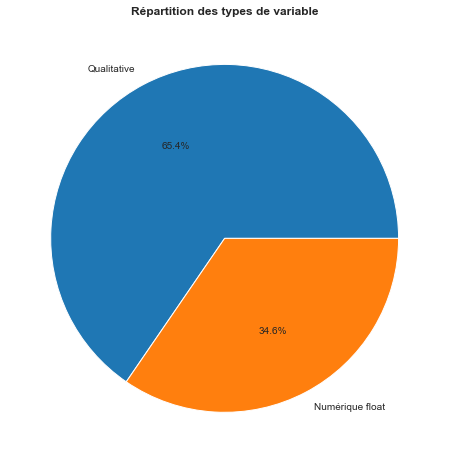

In [336]:
plt.figure(figsize=(8,8))
df.dtypes.value_counts().plot.pie(labels=['Qualitative','Numérique float','Numérique int'],autopct='%1.1f%%')
plt.ylabel('')
plt.title("Répartition des types de variable",fontweight='bold')

###  Valeurs manquantes

<font color = "grey"><i> Représentation graphique des valeurs manquantes </i></font>


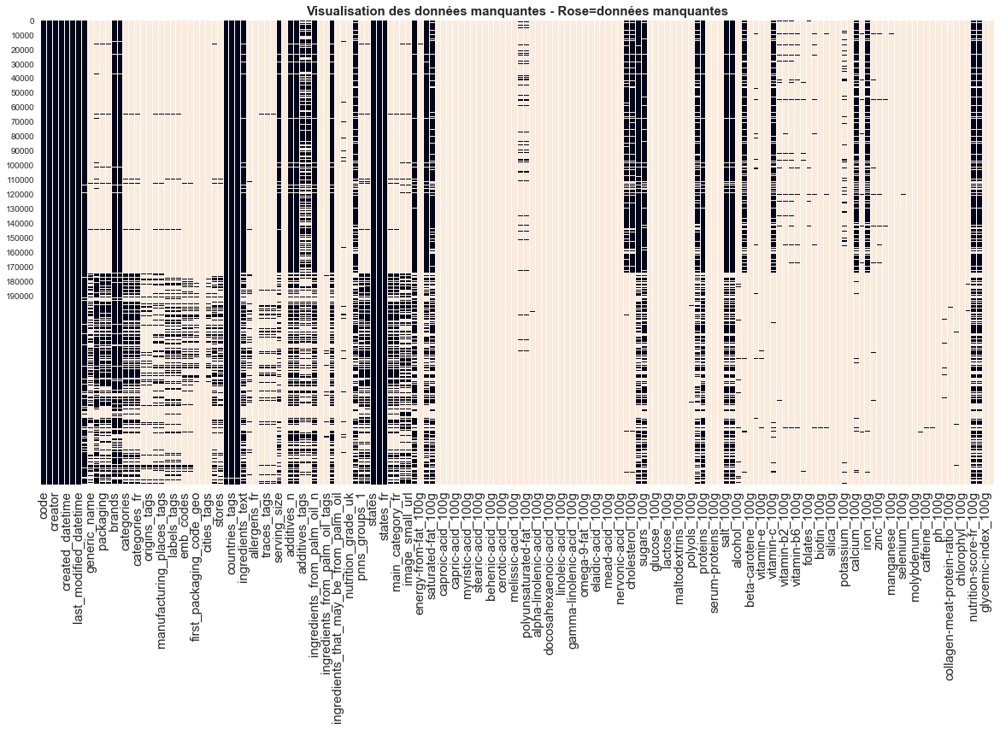

In [337]:
plt.figure(figsize=(20,10))
plt.title("Visualisation des données manquantes - Rose=données manquantes",fontweight='bold',fontsize=15)
sns.heatmap(data.isna(), cbar=False)
plt.xticks(fontsize='15')
plt.yticks(np.arange(0,200000,10000),np.arange(0,200000,10000),fontsize='10')
plt.show()


###  Premières observations


##  Analyse de données

##   Nettoyage du jeu de donnée

###  Supression de variable sans interêt
<font color = "grey"><i> Supression des variables ayant plus de 50% de valeurs manquantes </i></font>



In [338]:
wrong_var = df.columns[(df.isna().sum(axis = 0)/df.shape[0]) > 0.5]
df = df.drop(columns = wrong_var)
print("Le jeu de données est maintenant composé de",df.shape[1],"colonnes ou attributs et ",df.shape[0]," lignes",)

Le jeu de données est maintenant composé de 34 colonnes ou attributs et  320772  lignes


In [339]:
df.shape

(320772, 34)

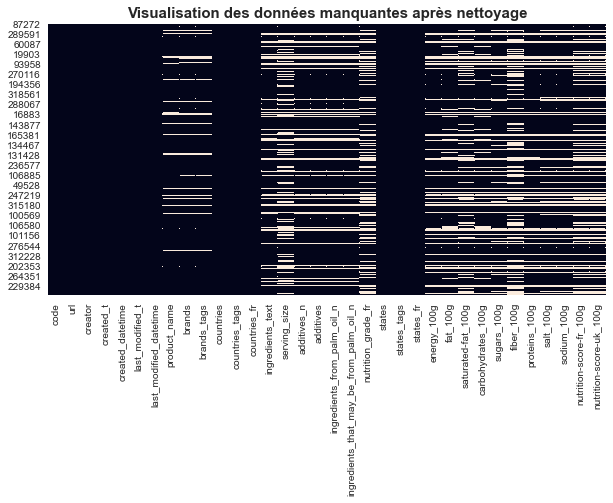

In [340]:
plt.figure(figsize=(10,5))
plt.title("Visualisation des données manquantes après nettoyage",fontweight='bold',fontsize=15)
sns.heatmap(df.sample(10000).isna(), cbar=False)
plt.xticks(fontsize='10')
plt.show()

###  Recherche et traitement des doublons

Nous considerons les produits ayant le même 'product_name', le même 'brands' et le même 'energy_100g" comme doublon

In [341]:
doublons_df = df[df.duplicated(subset=['product_name','brands','energy_100g'],keep='first')]
df = df.drop(index=doublons_df.index)

In [342]:
df.shape
print("Le jeu de données est maintenant composé de",df.shape[1],"colonnes ou attributs et ",df.shape[0]," lignes",)

Le jeu de données est maintenant composé de 34 colonnes ou attributs et  292882  lignes


###  Changement des types de données

In [343]:
df.created_datetime = pd.to_datetime(df.created_datetime,errors = 'coerce')
df.last_modified_datetime = pd.to_datetime(df.last_modified_datetime,errors = 'coerce')

cols = ['code',
        'product_name',
        'brands',
        'countries_fr',
        'ingredients_text',
        'additives',
        'nutrition_grade_fr']
df[cols] = df[cols].astype(pd.StringDtype())

###  Boite a moustache non clean

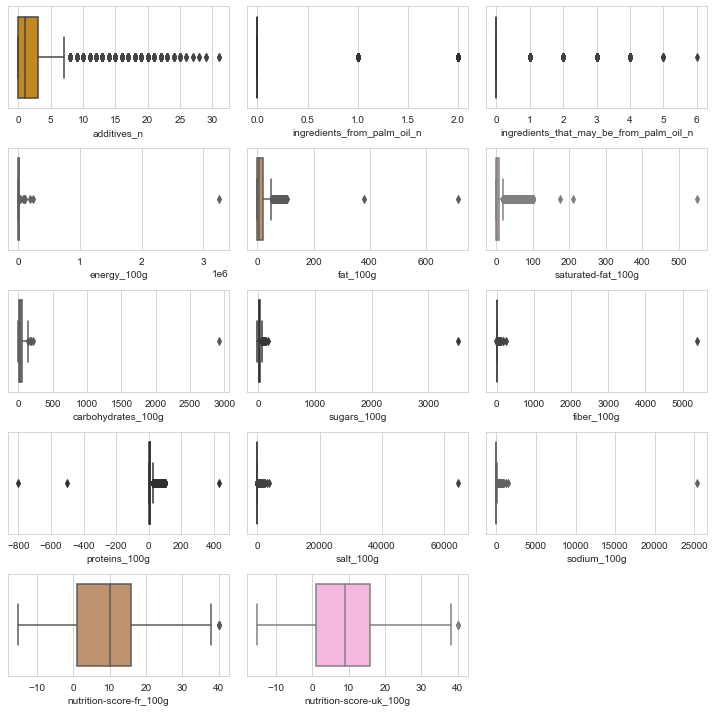

In [344]:
i = 0
colors = sns.color_palette("colorblind", 14)
plt.figure(figsize=(10,10))
sns.set_style("whitegrid")
for col in df.describe():
    i += 1
    plt.subplot(5,3,i)
    sns.boxplot(x = df[col],color = colors[i%8])
plt.tight_layout()

###  Sauvegarde des données

In [345]:
df.to_pickle("data/openfoodfact_clean")


###  Etude Univariée

In [346]:
df = pd.read_pickle('data/openfoodfact_clean')
df_test = df
## Variable quantitative

In [347]:
df_test.describe()

,additives_n,ingredients_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition-score-uk_100g
count,236438.000000,236438.000000,236438.000000,2.483590e+05,231255.000000,219233.000000,230943.000000,233491.000000,191819.000000,247206.000000,243089.000000,243049.000000,211629.000000,211629.000000
mean,1.938534,0.019853,0.055900,1.143176e+03,12.675133,5.127985,32.171326,15.914582,2.873285,7.107718,2.042205,0.804148,9.156264,9.049932
std,2.508246,0.141183,0.271499,6.607502e+03,17.341354,8.027113,29.690154,22.251075,13.135228,8.390446,131.493326,51.773283,9.056570,9.186410
min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,-17.860000,-6.700000,-800.000000,0.000000,0.000000,-15.000000,-15.000000
25%,0.000000,0.000000,0.000000,3.850000e+02,0.000000,0.000000,6.100000,1.300000,0.000000,0.710000,0.063500,0.025000,1.000000,1.000000
50%,1.000000,0.000000,0.000000,1.100000e+03,5.100000,1.790000,21.000000,5.700000,1.500000,4.810000,0.589280,0.232000,10.000000,9.000000
75%,3.000000,0.000000,0.000000,1.674000e+03,20.000000,7.140000,58.435000,24.000000,3.600000,10.000000,1.379220,0.543000,16.000000,16.000000
max,31.000000,2.000000,6.000000,3.251373e+06,714.290000,550.000000,2916.670000,3520.000000,5380.000000,430.000000,64312.800000,25320.000000,40.000000,40.000000


<font color = "grey"><i> Suppressions des variables sans information </i></font>



In [348]:
df_test = df_test.drop(columns=['ingredients_from_palm_oil_n','ingredients_that_may_be_from_palm_oil_n'])
df_test.describe()

,additives_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition-score-uk_100g
count,236438.000000,2.483590e+05,231255.000000,219233.000000,230943.000000,233491.000000,191819.000000,247206.000000,243089.000000,243049.000000,211629.000000,211629.000000
mean,1.938534,1.143176e+03,12.675133,5.127985,32.171326,15.914582,2.873285,7.107718,2.042205,0.804148,9.156264,9.049932
std,2.508246,6.607502e+03,17.341354,8.027113,29.690154,22.251075,13.135228,8.390446,131.493326,51.773283,9.056570,9.186410
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,-17.860000,-6.700000,-800.000000,0.000000,0.000000,-15.000000,-15.000000
25%,0.000000,3.850000e+02,0.000000,0.000000,6.100000,1.300000,0.000000,0.710000,0.063500,0.025000,1.000000,1.000000
50%,1.000000,1.100000e+03,5.100000,1.790000,21.000000,5.700000,1.500000,4.810000,0.589280,0.232000,10.000000,9.000000
75%,3.000000,1.674000e+03,20.000000,7.140000,58.435000,24.000000,3.600000,10.000000,1.379220,0.543000,16.000000,16.000000
max,31.000000,3.251373e+06,714.290000,550.000000,2916.670000,3520.000000,5380.000000,430.000000,64312.800000,25320.000000,40.000000,40.000000


<font color = "grey"><i> Suppressions des variables nutritive negative , du nutriscore uk et des 100g > 100 </i></font>


In [349]:
for col in ['fat_100g', 'saturated-fat_100g', 'carbohydrates_100g',
            'sugars_100g', 'fiber_100g', 'proteins_100g',
            'salt_100g', 'sodium_100g'
]:

    print(f'suppression de {df_test[(df_test[col]>100) | (df_test[col]<0)].shape[0]} valeurs abérante dans la colonne {col}')
    df_test = df_test.drop(index=df_test[(df_test[col]>100) | (df_test[col]<0)].index)


suppression de 4 valeurs abérante dans la colonne fat_100g
suppression de 2 valeurs abérante dans la colonne saturated-fat_100g
suppression de 18 valeurs abérante dans la colonne carbohydrates_100g
suppression de 7 valeurs abérante dans la colonne sugars_100g
suppression de 3 valeurs abérante dans la colonne fiber_100g
suppression de 2 valeurs abérante dans la colonne proteins_100g
suppression de 145 valeurs abérante dans la colonne salt_100g
suppression de 0 valeurs abérante dans la colonne sodium_100g


In [350]:
df_test.describe()

,additives_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition-score-uk_100g
count,236267.000000,2.481820e+05,231083.000000,219149.000000,230769.000000,233400.000000,191746.000000,247039.000000,242913.000000,242873.000000,211555.000000,211555.000000
mean,1.939403,1.142129e+03,12.676144,5.123984,32.164761,15.895371,2.842418,7.114503,1.584295,0.623840,9.154414,9.047978
std,2.508392,6.589877e+03,17.263666,7.919785,29.064099,21.025042,4.602108,8.124818,6.181130,2.433695,9.056180,9.185998
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.000000,-15.000000
25%,0.000000,3.850000e+02,0.000000,0.000000,6.100000,1.300000,0.000000,0.710000,0.063500,0.025000,1.000000,1.000000
50%,1.000000,1.100000e+03,5.130000,1.790000,21.000000,5.700000,1.500000,4.840000,0.589280,0.232000,10.000000,9.000000
75%,3.000000,1.674000e+03,20.000000,7.140000,58.460000,24.000000,3.600000,10.000000,1.371600,0.541000,16.000000,16.000000
max,31.000000,3.251373e+06,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,39.370079,40.000000,40.000000


###  Valeur de variable fille supérieure à celle de la variable mère

In [351]:
df_impossible=df_test[df_test['sugars_100g']>df_test['carbohydrates_100g']]
df_test.loc[df_impossible.index,"sugars_100g"]=df_test.loc[df_impossible.index,"carbohydrates_100g"]

In [352]:
df_impossible=df_test[df_test['saturated-fat_100g']>df_test['fat_100g']]
df_test.loc[df_impossible.index,"fat_100g"]=df_test.loc[df_impossible.index,"saturated-fat_100g"]

In [353]:
#fonction qui retourne le dataframe sans les outliers basés sur la régle des quantiles
def outliers_remover(data,col):
    Quant=data[col].quantile([0.25,0.5,0.75]).values #Calcul des quantiles

    if int(Quant[2]) == 0:
        print(f'pas de traitement car Q3=0')
        return data
    else:
        n=data[(data[col]<0) | (data[col]>=(Quant[1]+1.5*Quant[2]))].shape[0] # nombre d'outliers
        print(f'traitement de la colonne {col} suppression de {n} individus avec une valeur en dehors de l\'interval [0,{Quant[1]+1.5*Quant[2]}]')
        return data[(data[col]>= 0) & (data[col]<Quant[1]+1.5*Quant[2]) | (data[col].isna())]


###  Applications au données

In [354]:
df_test = outliers_remover(df_test,'energy_100g')
df_test = outliers_remover(df_test,'fiber_100g')

traitement de la colonne energy_100g suppression de 1031 individus avec une valeur en dehors de l'interval [0,3611.0]
traitement de la colonne fiber_100g suppression de 22960 individus avec une valeur en dehors de l'interval [0,6.9]


In [355]:
df_test.shape


(268710, 32)

###  Boite a moustache

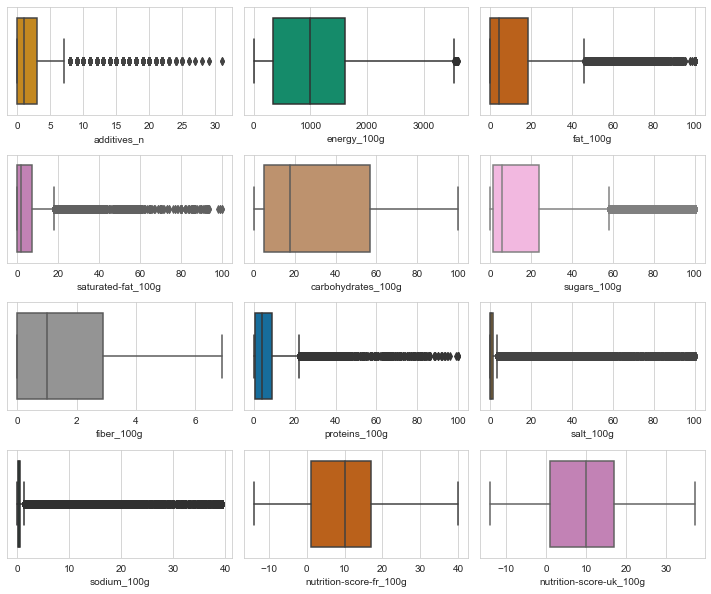

In [356]:
i = 0
colors = sns.color_palette("colorblind", 14)
plt.figure(figsize=(10,10))
sns.set_style("whitegrid")
for col in df_test.describe():
    i += 1
    plt.subplot(5,3,i)
    sns.boxplot(x = df_test[col],color = colors[i%8])
plt.tight_layout()


 Distributions

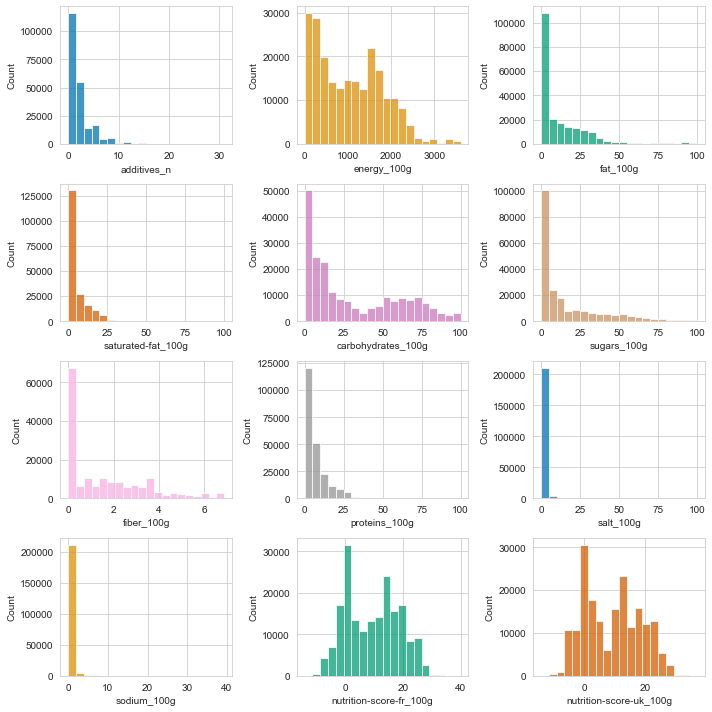

In [357]:
i = 0
fig, ax = plt.subplots(4,3)
fig.set_size_inches(10, 10)
for col in df_test.describe().columns:

    binw=(df_test[col].max()-df_test[col].min())/20
    sns.set_style("whitegrid")
    sns.histplot(x = df_test[col],binwidth = binw,ax = ax[i//3][i%3],color = colors[i%8])
    i += 1
plt.tight_layout()

###  Variables qualitatives

In [358]:
dict = {}
dict2 = {}
for col in df_test.select_dtypes('string'):
    print(col)
    dict[col] =  len(df_test[col].unique())
    dict2[col] =  (df_test[col].isna().sum(axis = 0)/df_test.shape[0])

pd.DataFrame({'column':dict.keys(),'unique':dict.values(),'pourcentage manquant':dict2.values()}).style.set_caption("Variables qualitatives")

code
product_name
brands
countries_fr
ingredients_text
additives
nutrition_grade_fr


,column,unique,pourcentage manquant
0,code,268707,0.000015
1,product_name,204058,0.009114
2,brands,55638,0.048722
3,countries_fr,661,0.000841
4,ingredients_text,181710,0.201474
5,additives,173983,0.201600
6,nutrition_grade_fr,6,0.296948


## Analyse Multivarié

## Corrélations

<font color = "grey"><i> Recherche de pairs de valeurs qui semblent etres corrélées </i></font>


In [359]:
def spearman_corel(df,col1,col2):
    df_correl = df_corr = df_test.dropna(subset=[col1, col2])
    spearman_result = spearmanr(df_corr[col1], df_corr[col2])[0]
    return spearman_result

In [360]:
cols = ['additives_n', 'energy_100g', 'fat_100g', 'saturated-fat_100g',
       'carbohydrates_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g',
       'salt_100g', 'nutrition-score-fr_100g']

In [361]:
df_correl = df_test.dropna(subset=['nutrition-score-fr_100g','nutrition-score-uk_100g'])
print(df_correl.shape)
spearmanr(df_correl['nutrition-score-fr_100g'],df_correl['nutrition-score-uk_100g'])

(188917, 32)


SpearmanrResult(correlation=0.9838746347556916, pvalue=0.0)

In [362]:
df_correl = df_test.dropna(subset=['salt_100g', 'sodium_100g'])
print(df_correl.shape)
spearmanr(df_correl['salt_100g'], df_correl['sodium_100g'])


(219207, 32)


SpearmanrResult(correlation=0.9999997445984092, pvalue=0.0)

<font color = "grey"><i> Suite à ces deux analyse nous pouvons supprimer ces deux variables de l'analyse </i></font>

In [363]:
df_test = df_test.drop(columns = ['nutrition-score-uk_100g','sodium_100g'])

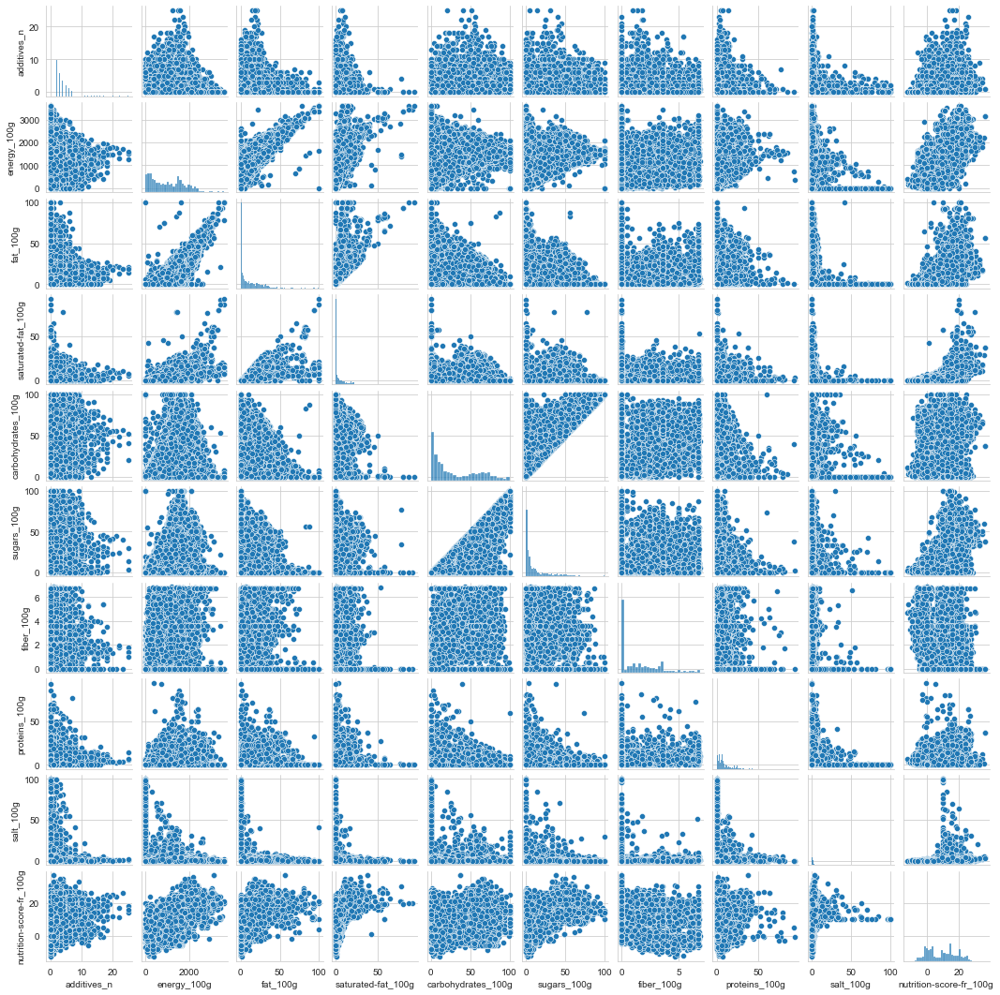

In [364]:
ax = sns.pairplot(df_test.sample(20000)[['additives_n', 'energy_100g', 'fat_100g',
                                       'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g',
                                       'fiber_100g', 'proteins_100g', 'salt_100g',
                                       'nutrition-score-fr_100g']],

                                    height = 1.5,
               )

<font color = "grey"><i> Sauvegarde du dataset </i></font>

In [365]:
df_test.to_pickle("data/openfoodfact_clean2")

In [366]:
df_test=pd.read_pickle("data/openfoodfact_clean2")


<font color = "grey"><i> Retrait des colonnes  'code','ingredients_text','additives' </i></font>

In [367]:
df_test=df_test.drop(columns=['code','ingredients_text','additives'])


Régression linéaire
<font color = "grey"><i> Création d'un dataframe pour la régression lineaire  </i></font>


In [368]:
df_incomplete=df_test[df_test['fat_100g'].isna() |
                     df_test['proteins_100g'].isna() |
                     df_test['carbohydrates_100g'].isna() |
                     df_test['energy_100g'].isna()
                     ]

In [369]:
df_complete=df_test.drop(index=df_incomplete.index)

In [370]:
df_complete.shape

(206469, 27)

<font color = "grey"><i> Création d'un objet régression lineaire  </i></font>

In [371]:
modeleReg=LinearRegression(fit_intercept=True)

<font color = "grey"><i> Création de l'axe X et Y </i></font>

In [372]:
X=df_complete[['fat_100g',
             'proteins_100g',
             'carbohydrates_100g',
             ]]
y=df_complete['energy_100g']

modeleReg.fit(X,y)

LinearRegression()

In [373]:
reg_coef=modeleReg.coef_
print(f'Linear regression coefficients are {reg_coef}')

a=np.linspace(0,1500,100)

Linear regression coefficients are [36.35406626 16.40921122 16.185229  ]


<font color = "grey"><i> calcul du R² </i></font>

R² is 0.961367979816122


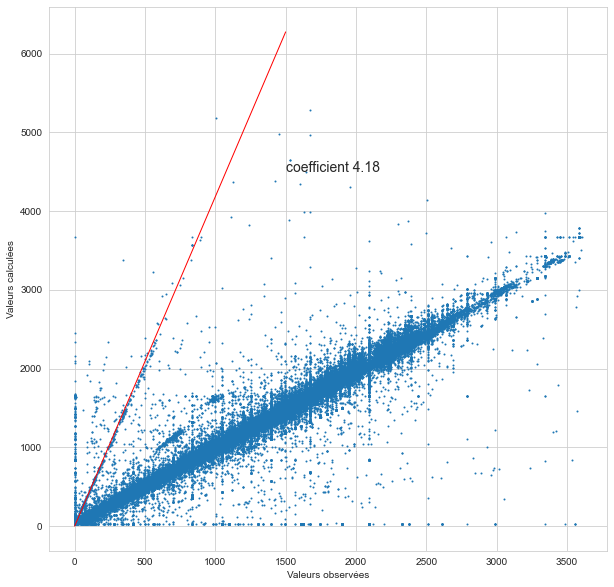

In [374]:
print(f'R² is {modeleReg.score(X,y)}')
plt.figure(figsize = (10,10))
plt.plot(y, modeleReg.predict(X),'.',markersize = 2)
plt.plot(a,a*4.184,color = 'red',linewidth = 1)
plt.xlabel('Valeurs observées')
plt.ylabel('Valeurs calculées')
plt.annotate('coefficient 4.18', xy = (1000, 4000), xytext = (1500, 4500),fontsize = 14
            )

plt.show()


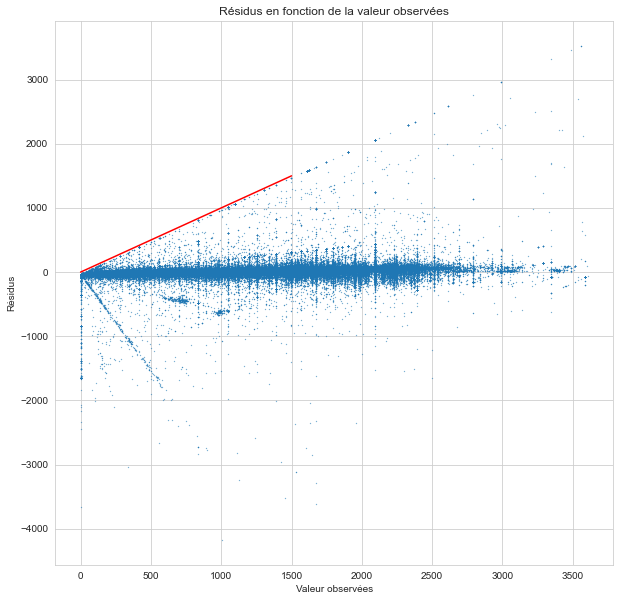

In [375]:
plt.figure(figsize = (10,10))
plt.plot(y, y-modeleReg.predict(X),'.',markersize = 0.5)
plt.plot(a,a,color = 'r')
plt.title('Résidus en fonction de la valeur observées')
plt.xlabel("Valeur observées")
plt.ylabel('Résidus')
plt.show()

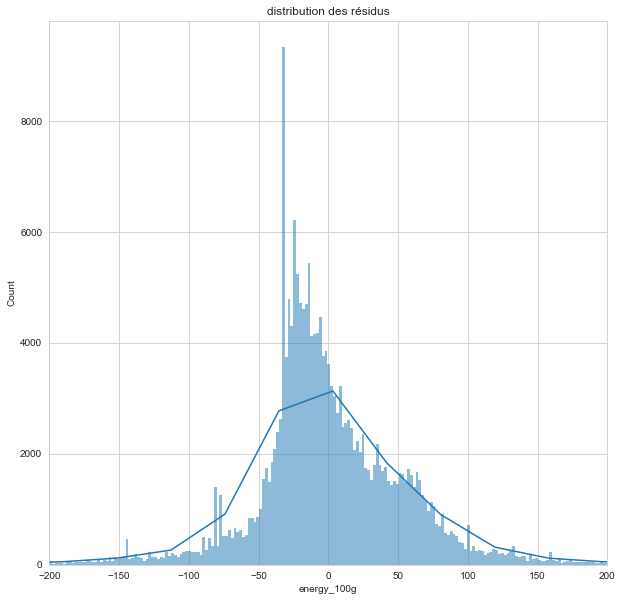

In [376]:
plt.figure(figsize=(10,10))
sns.histplot(y-modeleReg.predict(X),kde=True,kde_kws={'bw_adjust':2})
plt.xlim(-200,200)
plt.title('distribution des résidus')
#plt.xlim([-50,-30])
plt.show()

In [377]:
def plot_coef(method,titre):
    pcs = method.scalings_
    plt.figure(figsize=(16,8))

    plt.subplot(1,2,1)
    for i, (x,y) in enumerate(zip(pcs[:,0], pcs[:,1])):
        plt.plot([0,x],[0,y],'b--')
        plt.text(x,y,df_acp.columns[i], fontsize='12')
        plt.title(titre+' - premier plan')
        plt.xlabel('LD1')
        plt.ylabel('LD2')



    plt.subplot(1,2,2)
    for i, (x,y) in enumerate(zip(pcs[:,1], pcs[:,2])):
        plt.plot([0,x],[0,y],'b--')
        plt.text(x,y,df_acp.columns[i], fontsize='12')
        plt.title(titre+' - deuxième plan')
        plt.xlabel('LD2')
        plt.ylabel('LD3')



In [ ]:
df_acp_core=df_acp.copy()

In [ ]:
for col in cols:
    df_acp_core=df_acp_core.drop(index=df_acp_core[df_acp_core[col]>=df_acp_core[col].quantile(0.98)].index)

In [ ]:
df_acp_core.shape

In [ ]:
df_acp=df_acp_core[cols]
X=df_acp.values
m_scale = preprocessing.MinMaxScaler().fit(X)
X_scaled_m = m_scale.transform(X)
#soustraction de la moyenne pour centrage des données
for i in range(X_scaled_m.shape[1]):
    X_scaled_m[:,i]-=X_scaled_m[:,i].mean()

plt.figure(figsize=(8,5))
for i in range(X.shape[1]):
   sns.kdeplot(X_scaled_m[:,i])
plt.title('Distribution après MinMaxScaler et centrage',fontsize=15)
plt.legend(labels=cols)

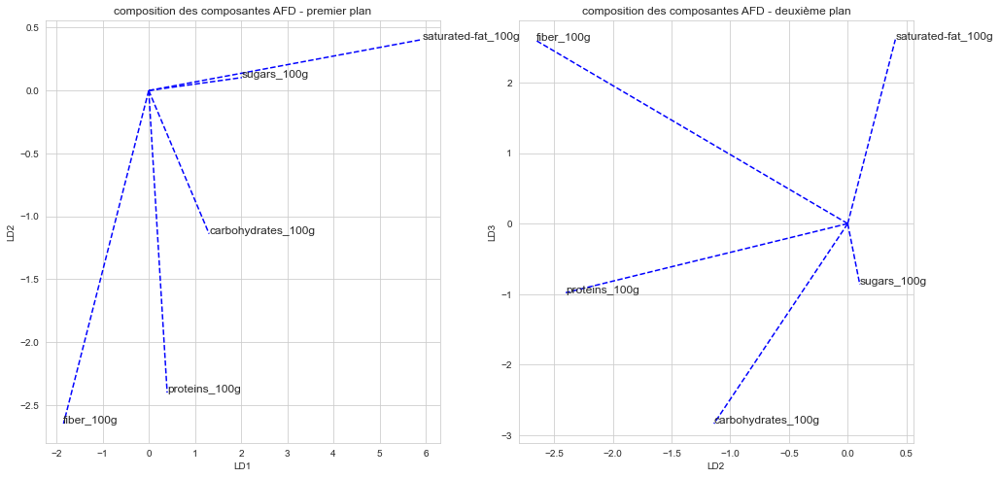

In [378]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
method = LinearDiscriminantAnalysis()
lda = method.fit(X_scaled_m, c)
X_r2 = lda.transform(X_scaled_m)

plot_coef(method,'composition des composantes AFD')

<font color = "grey"><i> Formule  des calories en kj </i></font>
## kJ= 37,2 x Lipide + 16,7 x Glucide + 16,7 x Proteines + 8.36 x Fibres

In [379]:
df_test['energie_calculée'] = (37.6*df_test['fat_100g']+
                               16.7*df_test['proteins_100g']+
                               16.7*df_test['carbohydrates_100g']
                              )

Traitement des erreurs d'unités
<font color = "grey"><i>  Selection des individus avec un coefficient de 4.18 à plus ou moins 25% </i></font>

In [380]:

df_units=df_test[(df_test['energy_100g'] < df_test['energie_calculée']/4.18*1.15) &
                        (df_test['energy_100g'] > df_test['energie_calculée']/4.18*0.85) ]

(0.0, 2500.0)

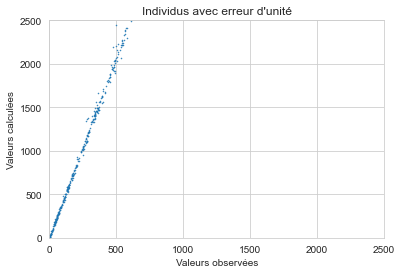

In [381]:
plt.plot(df_units['energy_100g'], df_units['energie_calculée'],'.',markersize = 1)
plt.xlabel('Valeurs observées')
plt.ylabel('Valeurs calculées')
plt.title('Individus avec erreur d\'unité')
plt.xlim([0,2500])
plt.ylim([0,2500])

In [382]:
df_units.shape

(376, 28)

<font color = "grey"><i>  Multiplions par 4.18 pour obternir la valeurs dans la bonne unités </i></font>

In [383]:
df_test.loc[df_units.index,"energy_100g"] = df_test.loc[df_units.index,"energy_100g"]*4.18

### Traitement des outliers

<font color = "grey"><i>  On définit les outliers via une erreur entre la valeur théorique et observé de plus ou moin 25% </i></font>

In [384]:
df_outliers = df_test[(df_test['energy_100g'] > df_test['energie_calculée']*1.25) |
                        (df_test['energy_100g'] < df_test['energie_calculée']*0.75) ]

In [385]:
df_outliers.describe()

,additives_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,nutrition-score-fr_100g,energie_calculée
count,11010.000000,11383.000000,11383.000000,7064.000000,11383.000000,9575.000000,6291.000000,11383.000000,11134.000000,6760.000000,11383.000000
mean,2.278111,555.950597,1.953986,1.154695,23.897742,10.068438,1.093277,2.199142,4.092725,5.203402,509.287834
std,2.799544,630.204939,7.500995,4.927079,30.284163,19.366960,1.545355,6.805728,9.923240,7.576833,611.845846
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-13.000000,0.000000
25%,0.000000,75.000000,0.000000,0.000000,2.480000,0.000000,0.000000,0.000000,0.010160,0.000000,59.619000
50%,1.000000,280.000000,0.000000,0.000000,7.140000,1.200000,0.000000,0.000000,0.726440,3.000000,222.611000
75%,3.000000,929.000000,0.000000,0.000000,40.000000,10.515000,2.200000,1.180000,2.631440,11.000000,858.240000
max,18.000000,3573.000000,100.000000,98.000000,100.000000,100.000000,6.800000,100.000000,99.905820,31.000000,5430.000000


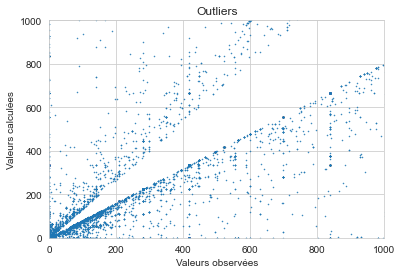

In [386]:
plt.plot(df_outliers['energy_100g'], df_outliers['energie_calculée'],'.',markersize=1)
plt.xlabel('Valeurs observées')
plt.ylabel('Valeurs calculées')
plt.title('Outliers')
plt.xlim([0,1000])
plt.ylim([0,1000])
plt.show()

In [387]:
df_test.describe()

,additives_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,nutrition-score-fr_100g,energie_calculée
count,214568.000000,224242.000000,208796.000000,195747.000000,208496.000000,210177.000000,168211.000000,223201.000000,219247.000000,188917.000000,206852.000000
mean,2.041362,1049.067415,11.478373,4.994575,30.518443,16.035623,1.608324,6.542403,1.634690,9.372936,1046.583654
std,2.547927,762.599651,15.970489,7.531089,29.172215,21.401305,1.812028,7.854938,6.417653,9.116785,772.204251
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-14.000000,0.000000
25%,0.000000,339.000000,0.000000,0.000000,5.200000,1.200000,0.000000,0.500000,0.078740,1.000000,331.542500
50%,1.000000,1000.000000,4.200000,1.760000,17.570000,5.600000,1.000000,4.080000,0.601980,10.000000,997.909000
75%,3.000000,1619.000000,18.420000,7.140000,56.900000,24.000000,2.900000,9.090000,1.400000,17.000000,1612.300000
max,31.000000,4715.040000,100.000000,100.000000,100.000000,100.000000,6.890000,100.000000,100.000000,40.000000,5430.000000


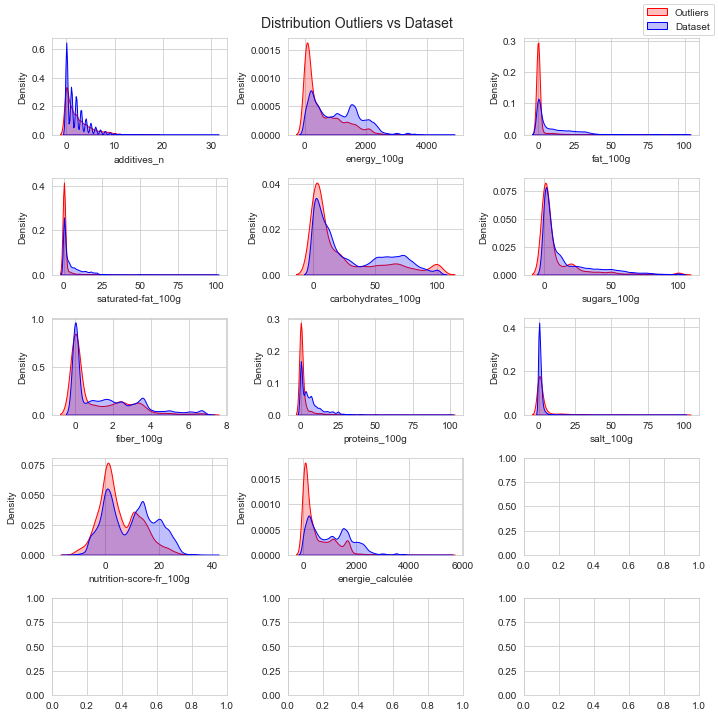

In [388]:
fig, ax = plt.subplots(5,3)
fig.set_size_inches(10, 10)
i=0
for col in df_test.describe().columns:

    #sns.kdeplot(x=df_impute.loc[i_mod][col],ax=ax[i//2][i%2],cmap="Reds", shade=True,label='valeurs imputées')
    sns.kdeplot(x = df_outliers[col],ax = ax[i//3][i%3],color='r', shade=True,label='Outliers')
    sns.kdeplot(x = df_test[col],ax = ax[i//3][i%3],color='b', shade=True, label='Dataset')
    i += 1
fig.legend(labels = ['Outliers','Dataset'])
fig.suptitle('Distribution Outliers vs Dataset',fontsize=14)
plt.tight_layout()
plt.show()

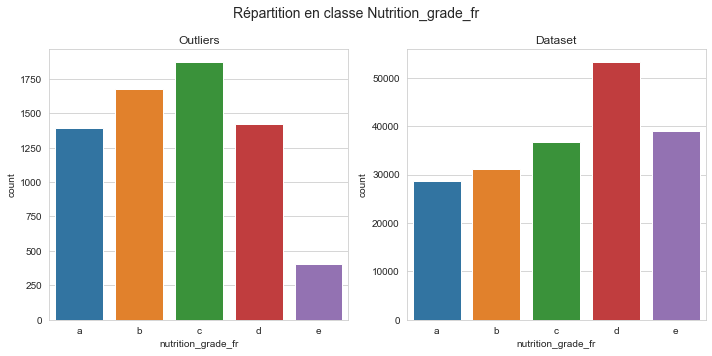

In [389]:
fig, ax = plt.subplots(1,2)
fig.set_size_inches(10, 5)


sns.countplot(data = df_outliers,x='nutrition_grade_fr',order=['a','b','c','d','e'], ax = ax[0])
ax[0].set_title('Outliers')
sns.countplot(data = df_test,x='nutrition_grade_fr',order=['a','b','c','d','e'], ax = ax[1])
ax[1].set_title('Dataset')
fig.suptitle('Répartition en classe Nutrition_grade_fr',fontsize = 14)
plt.tight_layout()
plt.show()

In [390]:
df_test = df_test.drop(index = df_outliers.index)

In [391]:
df_test = df_test.drop(columns = ['energie_calculée'])

####  Imputation des données

In [392]:
def imputated_value(data,table): #return the index of the imputed values
    i = 0
    index = []
    counter = 0
    for i in data.index:
        if data.loc[i][list(table.keys())].isna().sum() == 1:# check if there is one and only missing value
            for col_to_fill in table.keys():
                if np.isnan(data.loc[i][col_to_fill]):#identify the column of the missing value
                    data.loc[i,col_to_fill] = 0
                    cols = list(table.keys()) # creates the dictionnary of the other columns
                    cols.remove(col_to_fill)

                    for col in cols: #calculate the theoretical value
                        data.loc[i,col_to_fill] = data.loc[i,col_to_fill]-data.loc[i,col]*table[col]/table[col_to_fill]
                    if data.loc[i,col_to_fill] > 100:
                        data.loc[i,col_to_fill] = np.nan
                    elif data.loc[i,col_to_fill] < 0:
                        data.loc[i,col_to_fill] = np.nan
                    else:
                        index.append(i)
                        counter += 1
    print(f' modified {counter} values')
    return index


###Sur un echantillon pour test

In [393]:
df_test_sample=df_test.sample(20000)
df_test_sample_impute=df_test_sample.copy()


In [394]:
tab={'fat_100g': 37.2, 'proteins_100g': 16.7, 'carbohydrates_100g': 16.7,
     'fiber_100g': 8.36, 'energy_100g': -1,
    }

In [395]:
i_mod = imputated_value(df_test_sample_impute,tab)

 modified 2747 values


Effet sur les variables

In [396]:
cols=['fat_100g', 'proteins_100g', 'carbohydrates_100g',
     'fiber_100g', 'energy_100g']

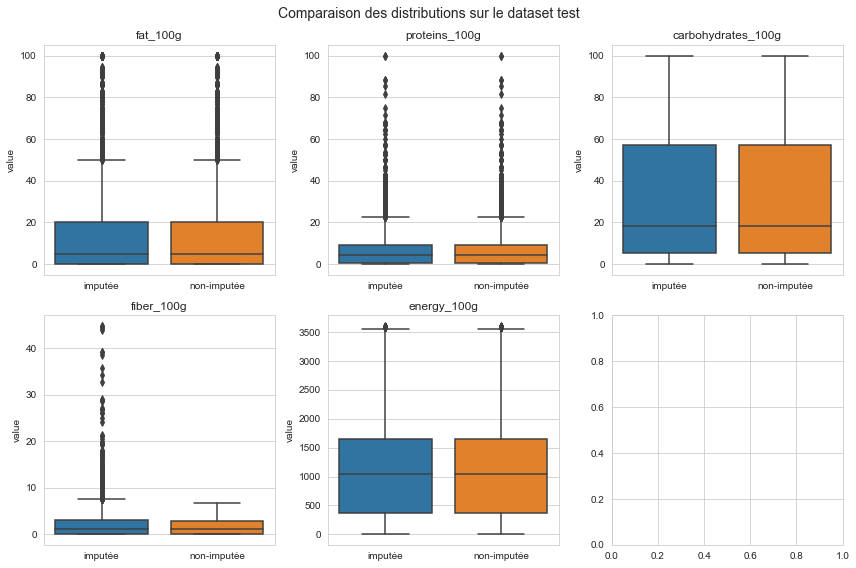

In [397]:
fig, axes = plt.subplots(2,3)
fig.set_size_inches(12, 8)
i = 0
for col in cols:
    T=pd.concat([df_test_sample_impute[col],df_test_sample[col]], axis = 1)
    T.columns=['imputée','non-imputée']
    ax = axes[i//3][i%3]
    sns.set_style("whitegrid")
    sns.boxplot(x= "variable", y = "value", data = pd.melt(T), ax = ax)
    ax.set_xlabel('')
    ax.set_title(f'{col}')
    i+=1
fig.suptitle('Comparaison des distributions sur le dataset test',fontsize = 14)
plt.tight_layout()

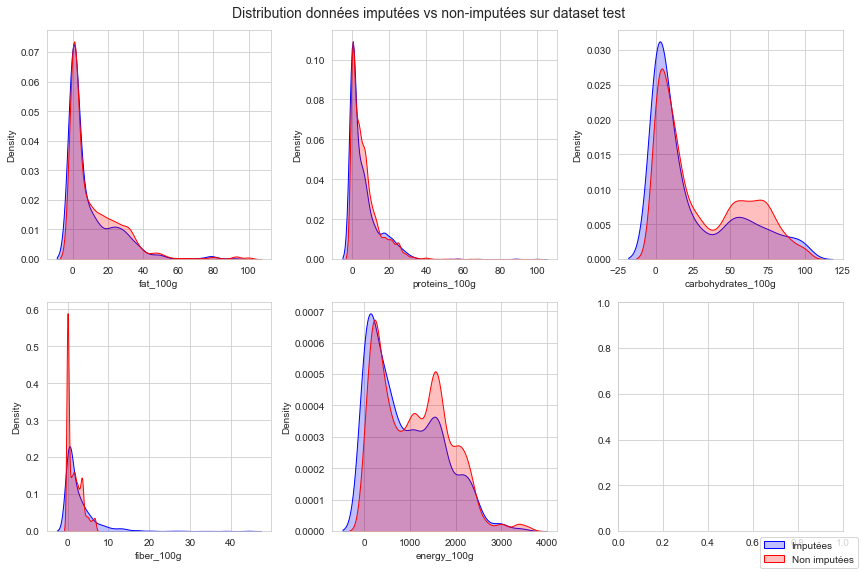

In [398]:
fig, ax = plt.subplots(2,3)
fig.set_size_inches(12, 8)
i = 0
for col in cols:


    sns.kdeplot(x = df_test_sample_impute.loc[i_mod,col],ax = ax[i//3][i%3],color='b', shade=True,label='dataset imputé')
    sns.kdeplot(x = df_test_sample[col],ax = ax[i//3][i%3],color = 'r', shade=True, label='dataset avant imputation')
    i += 1
fig.legend(labels = ['Imputées','Non imputées'],loc = 4)
fig.suptitle('Distribution données imputées vs non-imputées sur dataset test',fontsize = 14)
plt.tight_layout()

###### Application à toutes les données

Imputation

In [399]:
df_impute = df_test.copy()

L'imputation est une opération très couteuse,ici nous nous contentons de charger le résultats de l'opération faite au préalable

In [400]:
df_impute = pd.read_pickle("data/data_impute")

In [401]:
df_impute.shape

(257327, 27)

Effet sur les variables

In [402]:
cols = ['energy_100g', 'fat_100g','carbohydrates_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g']

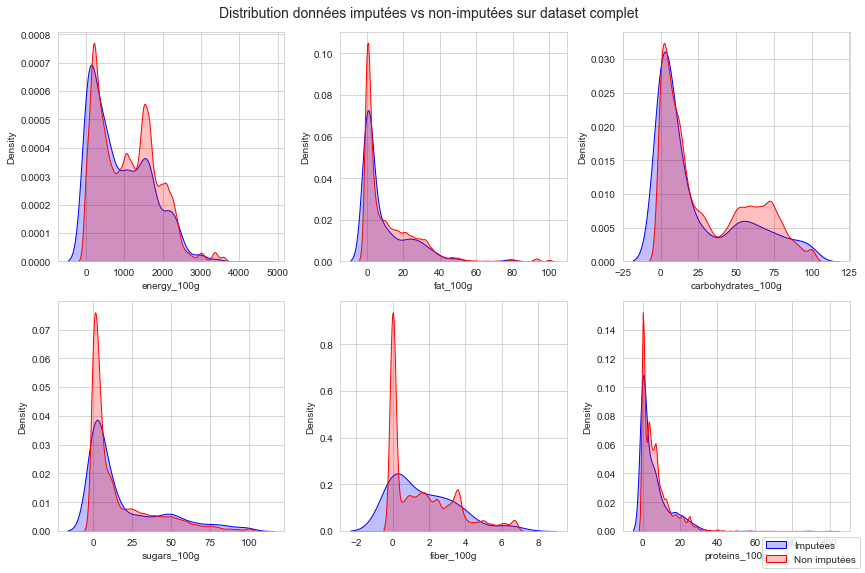

In [403]:
fig, ax = plt.subplots(2,3)
fig.set_size_inches(12, 8)
i = 0
for col in cols:

    sns.kdeplot(x = df_impute.loc[i_mod,col],ax = ax[i//3][i%3],color='b', shade = True,label = 'dataset imputé')
    sns.kdeplot(x = df_test[col],ax = ax[i//3][i%3],color='r', shade=True, label = 'dataset avant imputation')
    i += 1
fig.legend(labels = ['Imputées','Non imputées'],loc = 4)
fig.suptitle('Distribution données imputées vs non-imputées sur dataset complet',fontsize = 14)
plt.tight_layout()

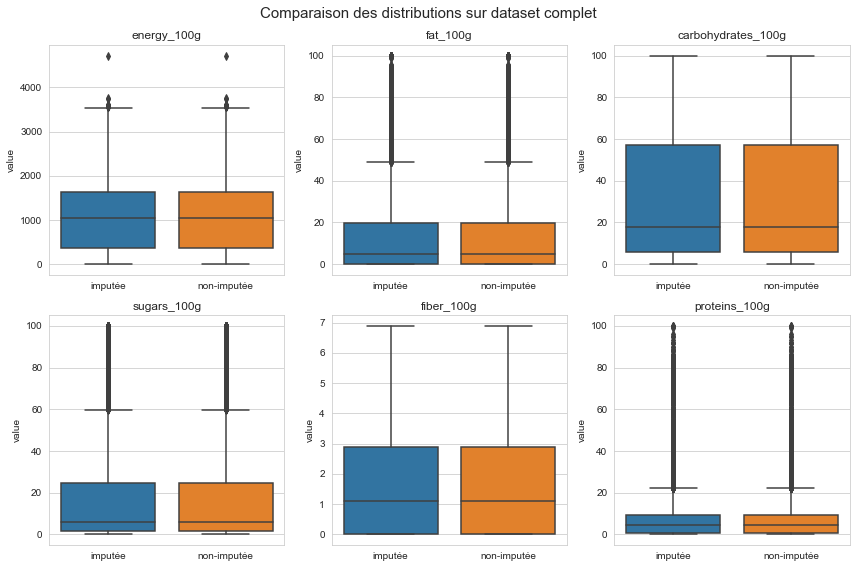

In [404]:
fig, axes = plt.subplots(2,3)
fig.set_size_inches(12, 8)
i = 0
for col in cols:
    T = pd.concat([df_impute[col],df_test[col]],axis = 1)
    T.columns = ['imputée','non-imputée']
    ax = axes[i//3][i%3]
    sns.boxplot(x = "variable", y = "value", data = pd.melt(T), ax = ax)
    ax.set_xlabel('')
    ax.set_title(f'{col}')
    i += 1
fig.suptitle('Comparaison des distributions sur dataset complet',fontsize=15)
plt.tight_layout()

df_impute.to_pickle("data/data_impute")


### Analyse en composantes principales (Principal component analysis)

In [405]:
df_impute = pd.read_pickle("data/data_impute")

In [406]:
df_impute.shape

(257327, 27)

In [407]:
df_acp = df_impute.copy()

Selection des variables pour l'analyse en composantes principales (ACP)

In [408]:
cols=['carbohydrates_100g','saturated-fat_100g', 'sugars_100g',
       'proteins_100g', 'fiber_100g']

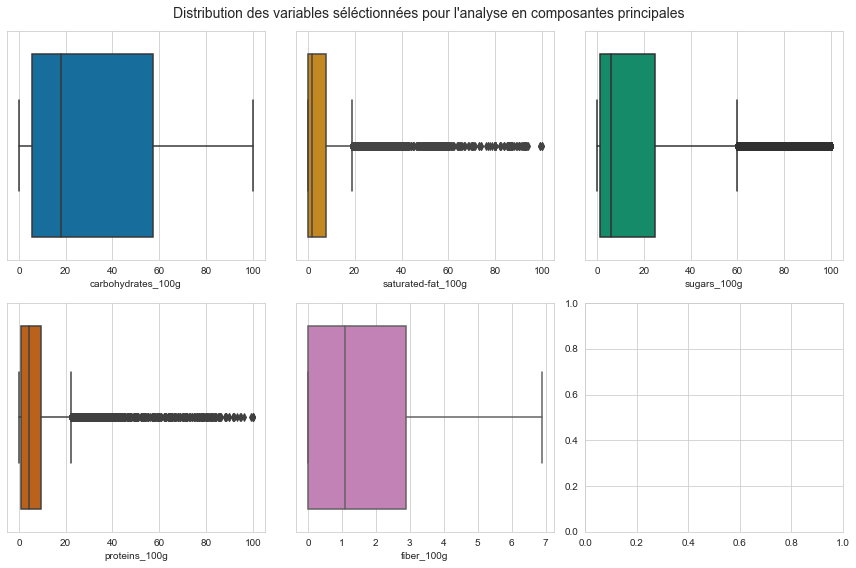

In [409]:
fig, axes = plt.subplots(2,3)
fig.set_size_inches(12, 8)
i = 0
colors = sns.color_palette("colorblind", 14)
for col in cols:
    ax = axes[i//3][i%3]
    sns.boxplot(x = df_impute[col],color = colors[i],ax = ax)
    i += 1
fig.suptitle('Distribution des variables séléctionnées pour l\'analyse en composantes principales',fontsize=14)
plt.tight_layout()


<font color = "grey"><i> Suppression des valeurs manquantes </i></font>


In [410]:
df_acp = df_acp.dropna(subset=cols)

In [411]:
df_acp.shape

(142142, 27)

<font color = "grey"><i> Mise de coté des outliers </i></font>


In [412]:
df_acp_core = df_acp.copy()

In [413]:
for col in cols:
    df_acp_core = df_acp_core.drop(index = df_acp_core[df_acp_core[col] >= df_acp_core[col].quantile(0.98)].index)

In [414]:
df_acp_core.shape

(127031, 27)

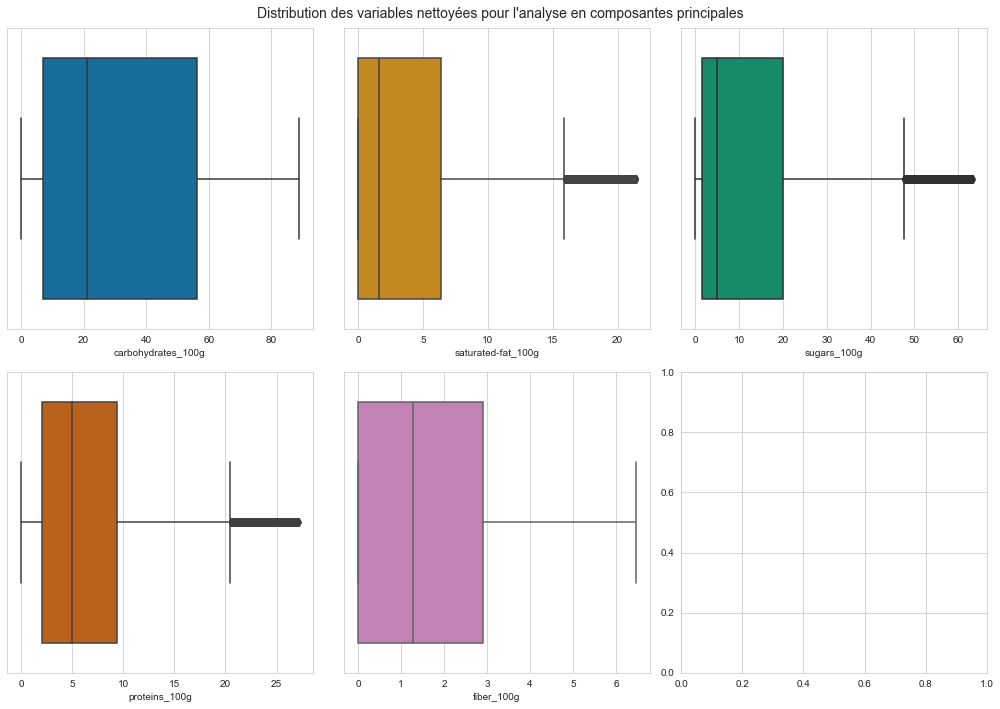

In [415]:
fig, axes = plt.subplots(2,3)
fig.set_size_inches(14, 10)
i = 0
colors=sns.color_palette("colorblind", 14)
for col in cols:
    ax = axes[i//3][i%3]
    sns.boxplot(x = df_acp_core[col],color = colors[i],ax = ax)
    i += 1
fig.suptitle('Distribution des variables nettoyées pour l\'analyse en composantes principales',fontsize=14)
plt.tight_layout()

In [416]:
df_ext = df_acp.drop(index = df_acp_core.index)

In [417]:
df_ext.shape

(15111, 27)

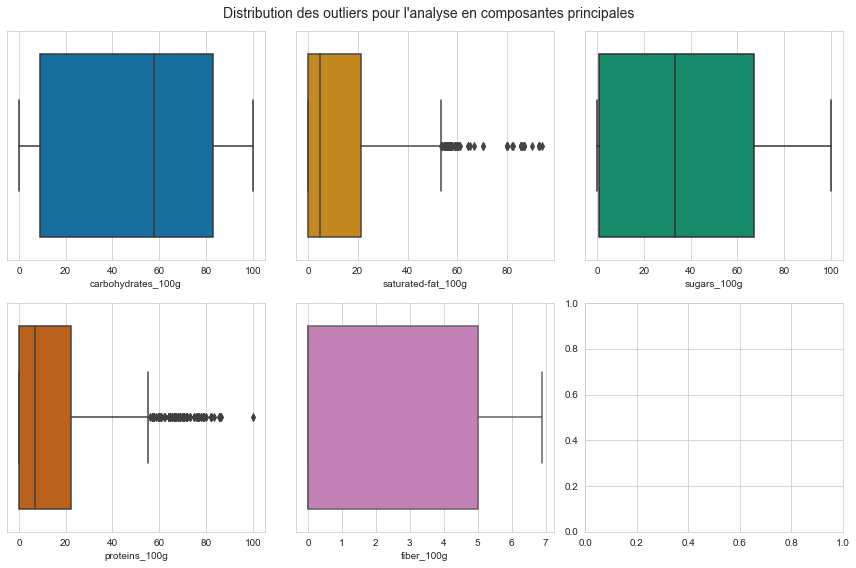

In [418]:
fig, axes = plt.subplots(2,3)
fig.set_size_inches(12, 8)
i = 0
colors=sns.color_palette("colorblind", 14)
for col in cols:
    ax=axes[i//3][i%3]
    sns.boxplot(x = df_ext[col],color = colors[i],ax = ax)
    i += 1
fig.suptitle('Distribution des outliers pour l\'analyse en composantes principales',fontsize = 14)
plt.tight_layout()

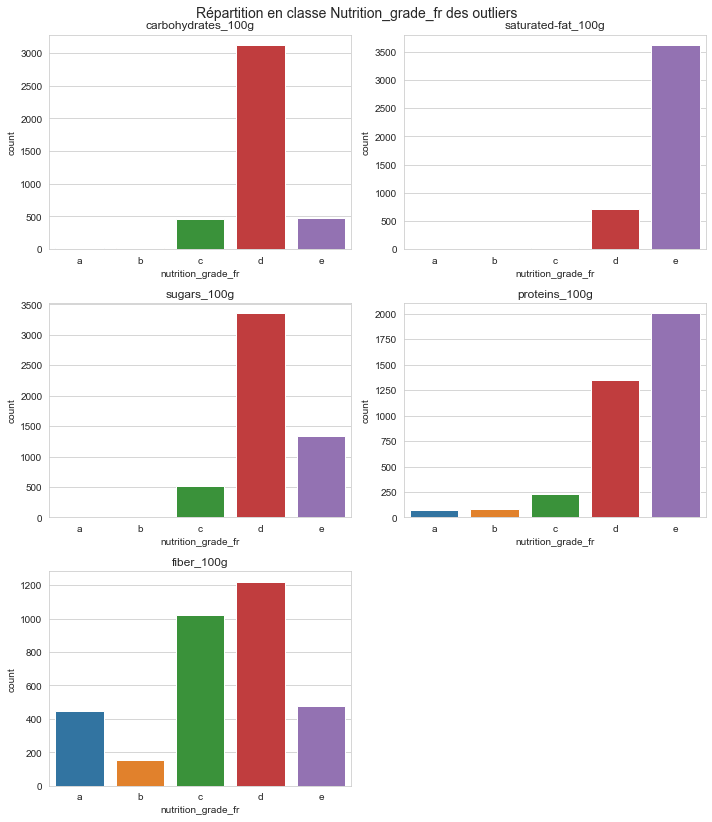

In [419]:
i = 0
plt.figure(figsize = (10,15))
for col in cols:
    i += 1
    plt.subplot(4,2,i)
    data = df_ext[df_ext[col]>df_acp[col].quantile(0.95)]
    sns.countplot(data = data,x = 'nutrition_grade_fr',order = ['a','b','c','d','e'])
    plt.title(col)
plt.suptitle('Répartition en classe Nutrition_grade_fr des outliers',fontsize = 14)
plt.tight_layout()

In [420]:
df_acp = df_acp_core[cols]

#### Preprocessing des données

##### Standard Scaler

In [421]:
from sklearn import preprocessing

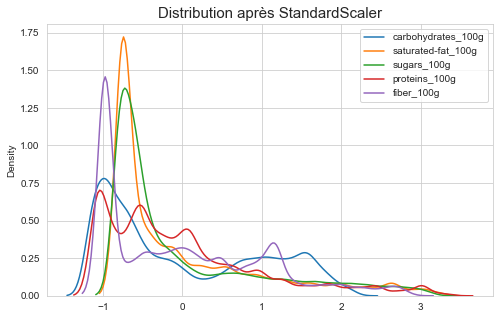

In [422]:
X=df_acp.values
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled_s = std_scale.transform(X)

plt.figure(figsize = (8,5))
for i in range(X.shape[1]):
   sns.kdeplot(X_scaled_s[:,i])
plt.title('Distribution après StandardScaler',fontsize = 15)
plt.legend(labels = cols)

In [423]:
X_scaled_s.mean(axis = 0)

array([-8.36781520e-17,  5.50396401e-17, -1.53037048e-16, -1.25293490e-17,
       -1.19923769e-16])

##### Min-max Scaler


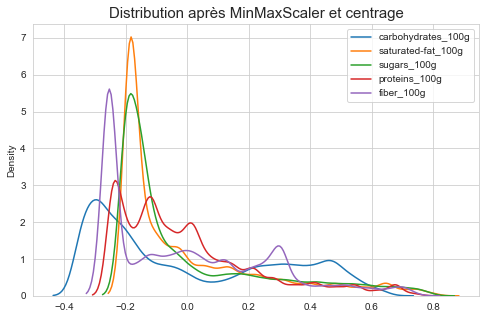

In [424]:
X=df_acp.values
m_scale = preprocessing.MinMaxScaler().fit(X)
X_scaled_m = m_scale.transform(X)
#soustraction de la moyenne pour centrage des données
for i in range(X_scaled_m.shape[1]):
    X_scaled_m[:,i]-=X_scaled_m[:,i].mean()

plt.figure(figsize = (8,5))
for i in range(X.shape[1]):
   sns.kdeplot(X_scaled_m[:,i])
plt.title('Distribution après MinMaxScaler et centrage',fontsize = 15)
plt.legend(labels = cols)

In [425]:
X_scaled_m.mean(axis = 0)

array([ 9.07259108e-17, -2.57299130e-18, -6.46603902e-17, -2.23738374e-18,
       -5.59345936e-18])

##### Robust Scaler


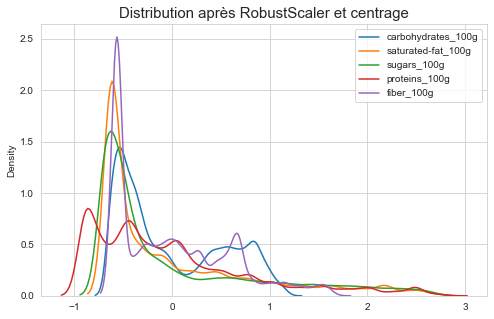

In [426]:
X=df_acp.values
r_scale = preprocessing.RobustScaler().fit(X)
X_scaled_r = r_scale.transform(X)
#soustraction de la moyenne pour centrage des données
for i in range(X_scaled_m.shape[1]):
    X_scaled_r[:,i]-=X_scaled_r[:,i].mean()

plt.figure(figsize = (8,5))
for i in range(X.shape[1]):
   sns.kdeplot(X_scaled_r[:,i])
plt.title('Distribution après RobustScaler et centrage',fontsize = 15)
plt.legend(labels = cols)

In [427]:
X_scaled_r.mean(axis = 0)

array([ 7.15962798e-18, -9.39701172e-18,  7.15962798e-18, -3.57981399e-18,
        1.43192560e-17])

#### Calcul des composantes principales

In [428]:
from sklearn import decomposition

In [429]:
pca_s = decomposition.PCA(n_components=5)
pca_s.fit(X_scaled_s)

pca_m = decomposition.PCA(n_components=5)
pca_m.fit(X_scaled_m)

pca_r = decomposition.PCA(n_components=5)
pca_r.fit(X_scaled_r)

PCA(n_components=5)

#### Eboulis des valeurs propres

In [430]:
dict_col = {"Variance expliquée":pca_s.explained_variance_ratio_, "Variance expliquée cumulée":pca_s.explained_variance_ratio_.cumsum()}
pd.DataFrame.from_dict(dict_col).style.set_caption("Axes principaux avec StandardScaler")

,Variance expliquée,Variance expliquée cumulée
0,0.369241,0.369241
1,0.252738,0.621979
2,0.217810,0.839789
3,0.107971,0.947761
4,0.052239,1.000000


In [431]:
#StandardScaler follows Standard Normal Distribution (SND). Therefore, it makes mean = 0 and scales the data to unit variance. MinMaxScaler scales all the data features in the range [0, 1] or else in the range [-1, 1] if there are negative values in the dataset
dict_col = {"Variance expliquée":pca_m.explained_variance_ratio_, "Variance expliquée cumulée":pca_m.explained_variance_ratio_.cumsum()}
pd.DataFrame.from_dict(dict_col).style.set_caption("Axes principaux avec MinMaxScaler")

,Variance expliquée,Variance expliquée cumulée
0,0.419702,0.419702
1,0.218022,0.637724
2,0.203451,0.841175
3,0.105530,0.946705
4,0.053295,1.000000


In [432]:
#You could use RobustScaler if you have outliers and want to reduce their influence
dict_col = {"Variance expliquée":pca_r.explained_variance_ratio_, "Variance expliquée cumulée":pca_r.explained_variance_ratio_.cumsum()}
pd.DataFrame.from_dict(dict_col).style.set_caption("Axes principaux avec RobustScaler")



,Variance expliquée,Variance expliquée cumulée
0,0.379341,0.379341
1,0.314637,0.693978
2,0.164820,0.858798
3,0.101498,0.960296
4,0.039704,1.000000


Text(0.5, 1.0, 'Variance expliquée : Robust Scaler')

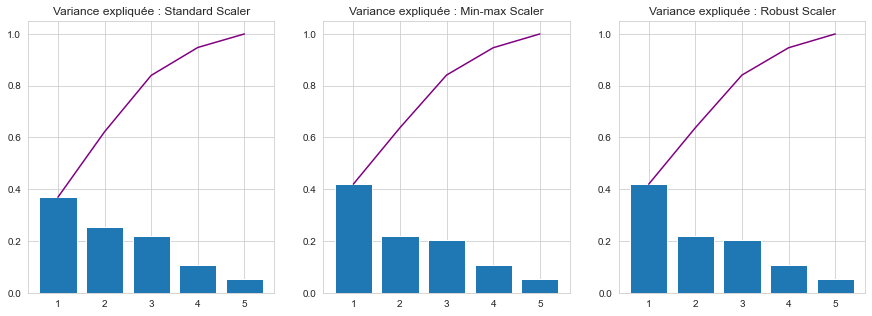

In [433]:
plt.figure(figsize=(15, 5))

val=pca_s.explained_variance_ratio_

plt.subplot(1, 3, 1)
plt.bar(np.arange(len(val))+1,val)
plt.plot(np.arange(len(val))+1,val.cumsum(),c = 'purple')
plt.title('Variance expliquée : Standard Scaler')

val=pca_m.explained_variance_ratio_

plt.subplot(1, 3, 2)
plt.bar(np.arange(len(val))+1,val)
plt.plot(np.arange(len(val))+1,val.cumsum(),c = 'purple')
plt.title('Variance expliquée : Min-max Scaler')

val=pca_m.explained_variance_ratio_

plt.subplot(1, 3, 3)
plt.bar(np.arange(len(val))+1,val)
plt.plot(np.arange(len(val))+1,val.cumsum(),c = 'purple')
plt.title('Variance expliquée : Robust Scaler')

#### Projection des individus

In [434]:
def plot_ind(X, pca, titre):

    #projection de X sur les composantes principales
    X_projected = pca.transform(X)


    fig = plt.figure(figsize=(16,8))
    plt.title(titre)

    plt.subplot(1,2,1)
    sns.scatterplot(x = X_projected[:,0], y = X_projected[:,1],s = 2)
    plt.title(titre+'- premier plan')
    plt.xlabel(f'PC1 - {round(pca.explained_variance_ratio_[0],3)*100}%')
    plt.ylabel(f'PC2 - {round(pca.explained_variance_ratio_[1],3)*100}%')

    plt.subplot(1,2,2)
    sns.scatterplot(x = X_projected[:,1], y = X_projected[:,2],s = 2)
    plt.xlabel(f'PC2 - {round(pca.explained_variance_ratio_[1],3)*100}%')
    plt.ylabel(f'PC3 - {round(pca.explained_variance_ratio_[2],3)*100}%')

    plt.title(titre + '- second plan')
    plt.show()

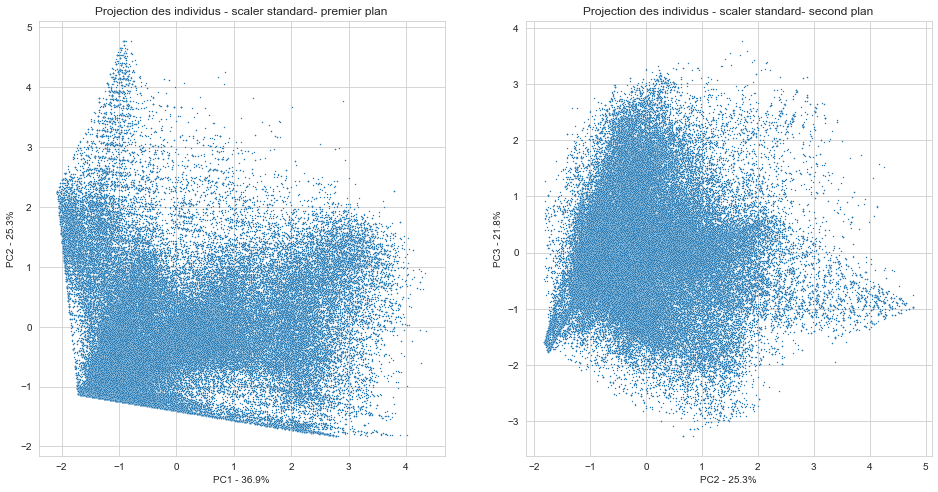

In [435]:
plot_ind(X_scaled_s, pca_s,'Projection des individus - scaler standard')

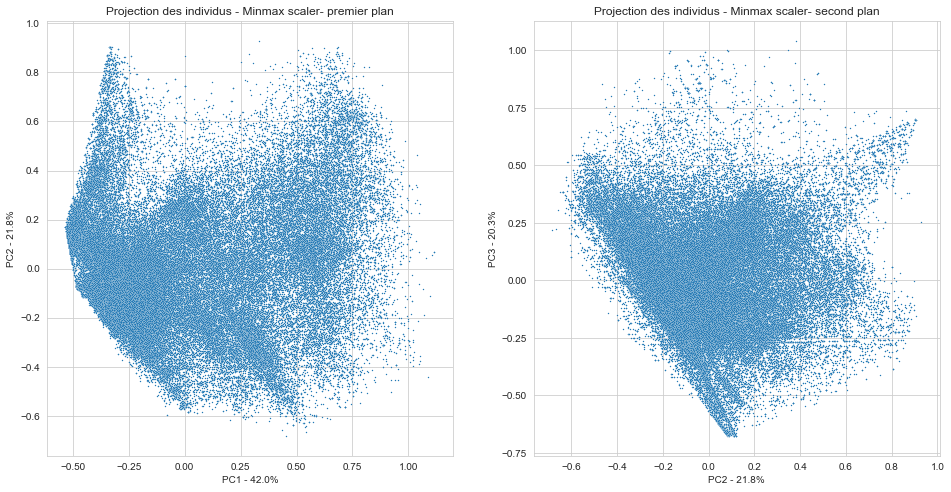

In [436]:
plot_ind(X_scaled_m, pca_m,'Projection des individus - Minmax scaler')

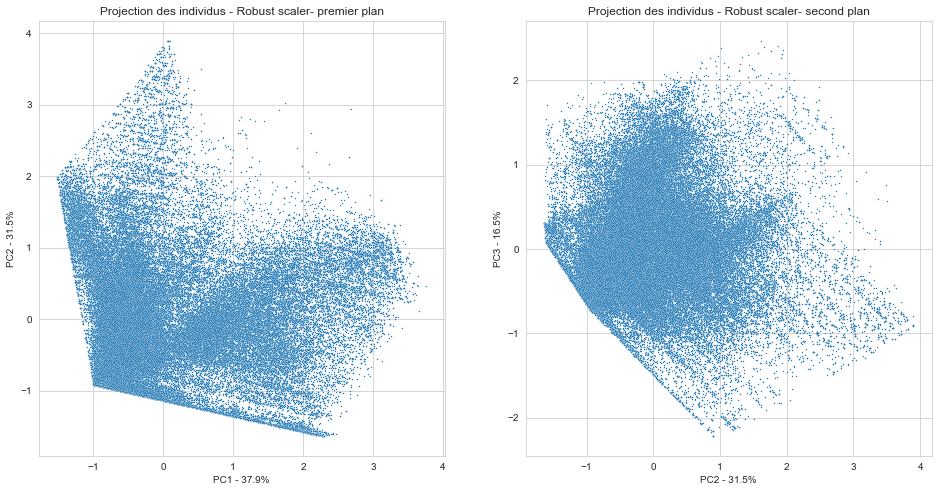

In [437]:
plot_ind(X_scaled_r, pca_r,'Projection des individus - Robust scaler')

L’analyse factorielle discriminante (AFD)

#### Projection de tous les individus (outliers inclut)

In [438]:
df_impute.shape

(257327, 27)

In [439]:
df_tot_acp=df_impute[cols]

In [440]:
df_tot_acp=df_tot_acp.dropna()

In [441]:
df_tot_acp.shape

(142142, 5)

In [442]:
X_scaled_tot_s = std_scale.transform(df_tot_acp.values)

In [443]:
X_scaled_tot_m = m_scale.transform(df_tot_acp.values)
for i in range(X_scaled_m.shape[1]):
    X_scaled_tot_m[:,i]-=X_scaled_m[:,i].mean()

In [444]:
X_scaled_tot_r = r_scale.transform(df_tot_acp.values)
for i in range(X_scaled_r.shape[1]):
    X_scaled_tot_r[:,i]-=X_scaled_tot_r[:,i].mean()

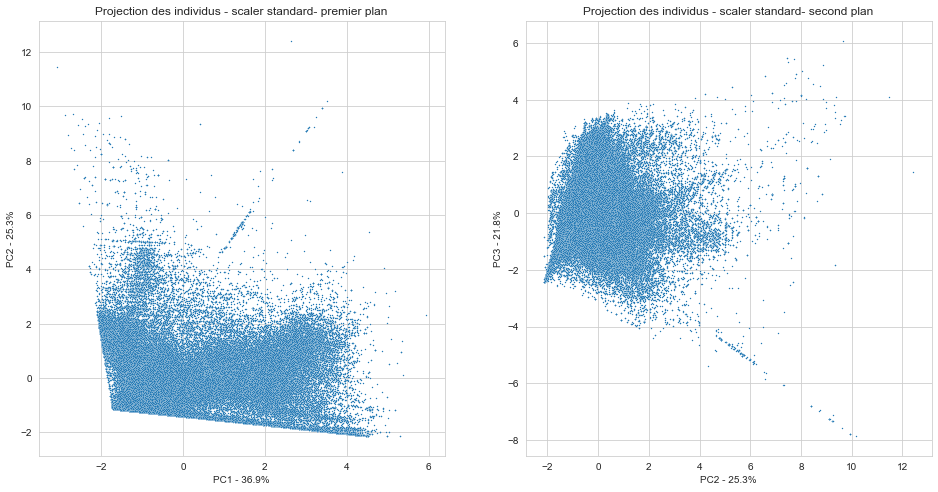

In [445]:
plot_ind(X_scaled_tot_s,pca_s,'Projection des individus - scaler standard')

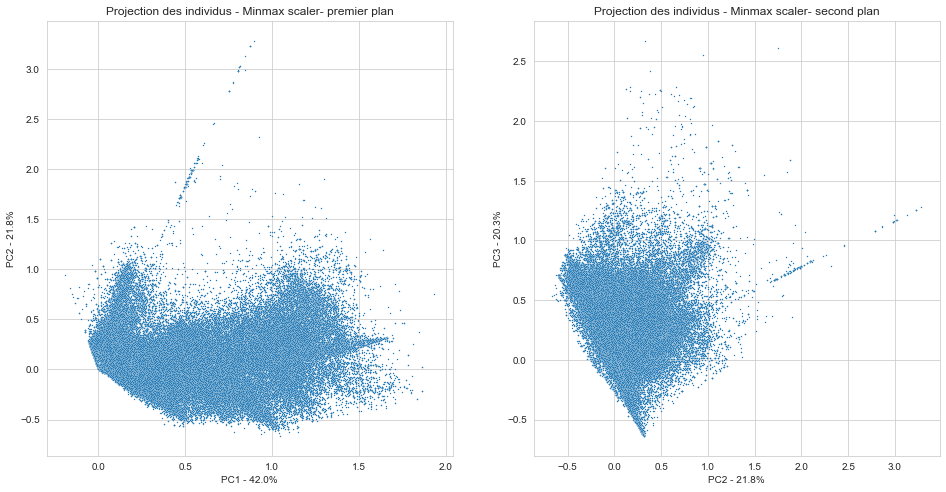

In [446]:
plot_ind(X_scaled_tot_m,pca_m,'Projection des individus - Minmax scaler')

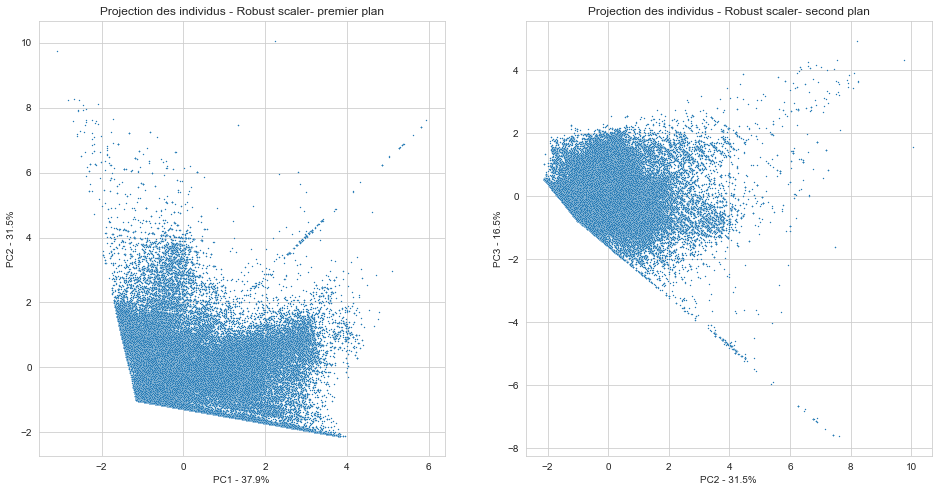

In [447]:
plot_ind(X_scaled_tot_r,pca_r,'Projection des individus - Robust scaler')

#### Contribution de chaque variables aux composantes principales

In [448]:
def plot_variables(pca,titre):
    pcs = pca.components_
    plt.figure(figsize=(16,8))

    plt.subplot(1,2,1)
    for i, (x,y) in enumerate(zip(pcs[0,:], pcs[1,:])):
        plt.plot([0, x],[0, y],'b--')
        plt.text(x, y, df_acp.columns[i], fontsize='12')
        plt.title(titre+' - premier plan')
        plt.xlabel(f'PC1 - {round(pca.explained_variance_ratio_[0],3)*100}%')
        plt.ylabel(f'PC2 - {round(pca.explained_variance_ratio_[1],3)*100}%')

    # Afficher une ligne horizontale y=0
    plt.plot([-0.7, 0.7], [0, 0], color='grey', ls='--')
    # Afficher une ligne verticale x=0
    plt.plot([0, 0], [-0.7, 0.7], color='grey', ls='--')

    plt.subplot(1,2,2)
    for i, (x, y) in enumerate(zip(pcs[1,:], pcs[2,:])):
        plt.plot([0,x],[0,y],'b--')
        plt.text(x,y,df_acp.columns[i], fontsize='12')
        plt.title(titre + ' - deuxième plan')
        plt.xlabel(f'PC2 - {round(pca.explained_variance_ratio_[1], 3)*100}%')
        plt.ylabel(f'PC3 - {round(pca.explained_variance_ratio_[2], 3)*100}%')

     # Afficher une ligne horizontale y=0
    plt.plot([-0.7, 0.7], [0, 0], color='grey', ls='--')
    # Afficher une ligne verticale x=0
    plt.plot([0, 0], [-0.7, 0.7], color='grey', ls='--')


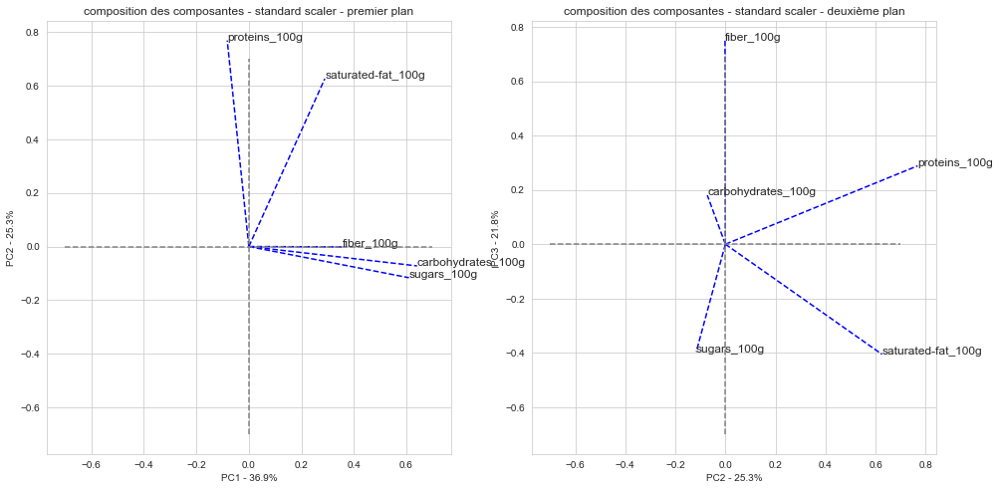

In [449]:
plot_variables(pca_s,'composition des composantes - standard scaler')

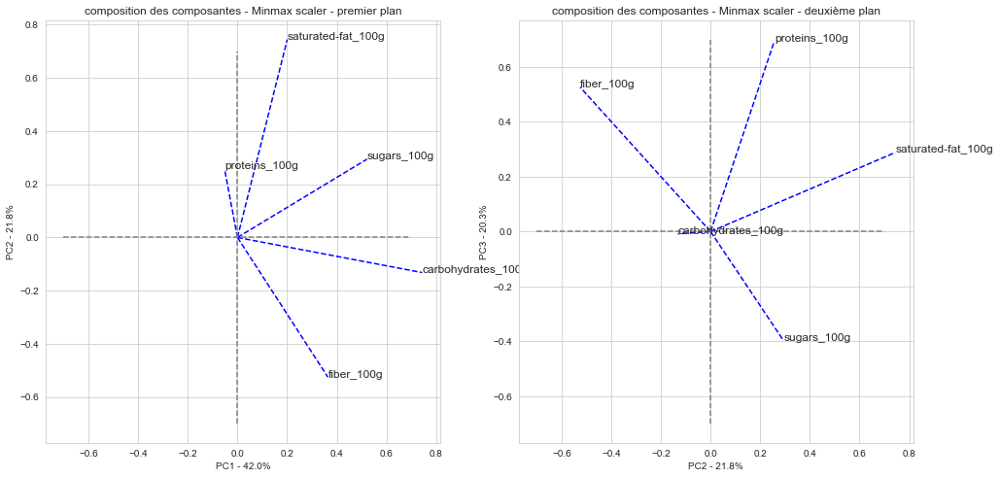

In [450]:
plot_variables(pca_m,'composition des composantes - Minmax scaler')

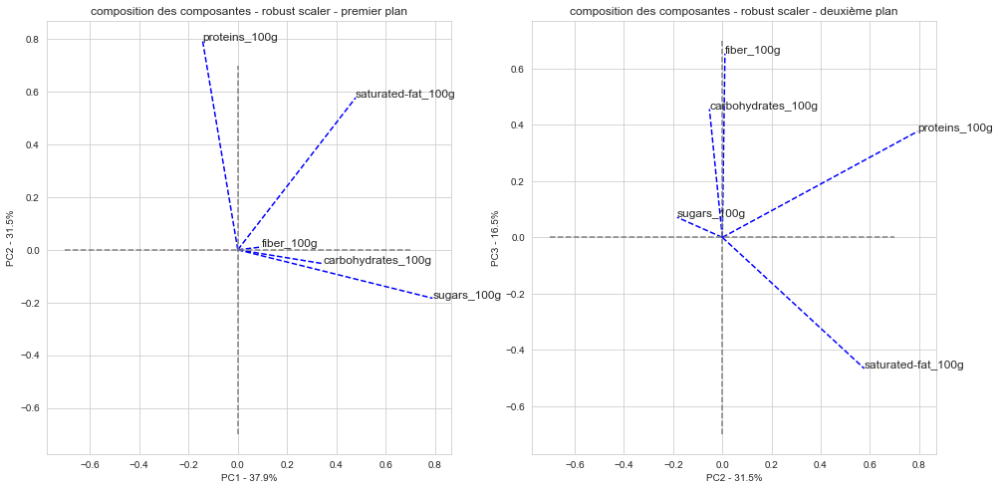

In [451]:
plot_variables(pca_r,'composition des composantes - robust scaler')

In [452]:
### AFD sur nutrition_grade_fr
# disciminer la nutrition_grade_fr

In [453]:
fillerNan = df_impute.loc[df_acp.index]['nutrition_grade_fr']

In [454]:
fillerNan_tot = df_impute.loc[df_tot_acp.index]['nutrition_grade_fr']

In [455]:
fillerNan = fillerNan.fillna('0')
fillerNan_tot = fillerNan_tot.fillna('0')

In [456]:
X_projected = pca_s.transform(X_scaled_s)

In [457]:
method = LinearDiscriminantAnalysis()
lda = method.fit(X_scaled_m, fillerNan)
X_r2 = lda.transform(X_scaled_m)

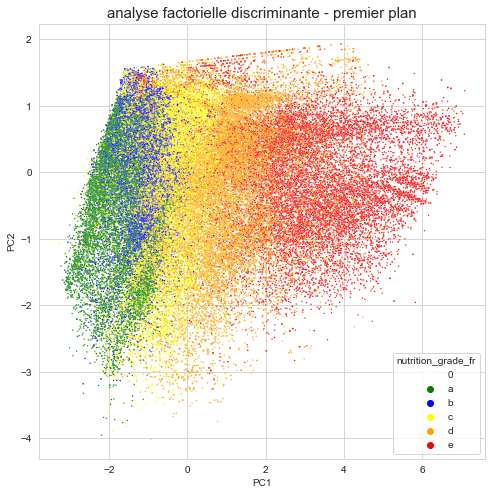

In [458]:
plt.figure(figsize=(8,8))
sns.scatterplot(x=X_r2[:,0],
                y=X_r2[:,1],
                s=2,
                palette={'a':'green', 'b':'blue', 'c':'yellow',
                         'd':'orange', 'e':'red','0':'white'
                        },
                hue = fillerNan,
                hue_order = ['0','a','b','c','d','e']
)
plt.title('analyse factorielle discriminante - premier plan',fontsize = 15)
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.show()

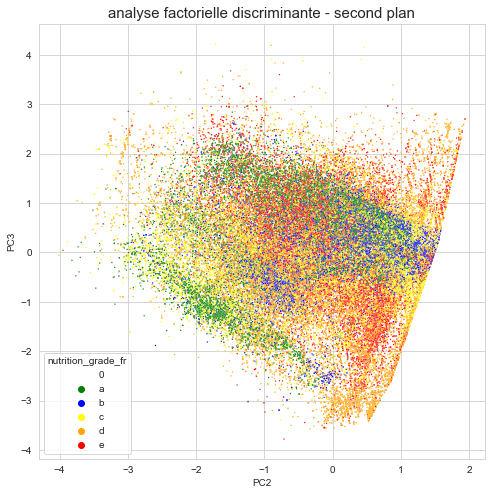

In [459]:
plt.figure(figsize=(8,8))
sns.scatterplot(x = X_r2[:,1],
                y = X_r2[:,2],
                s = 2,
                palette = {'a':'green', 'b':'blue', 'c':'yellow',
                           'd':'orange', 'e':'red', '0':'white'
                },
                hue = fillerNan,
                hue_order=['0','a','b','c','d','e']
)
plt.title('analyse factorielle discriminante - second plan',fontsize=15)
plt.xlabel('PC2')
plt.ylabel('PC3')
plt.show()


In [460]:
X_projected = X_r2

fig = px.scatter_3d(
              x=X_projected[:,0],
              y=X_projected[:,1],
              z=X_projected[:,2],
              color= fillerNan,
              color_discrete_map={
                  'a':'green', 'b':'blue', 'c':'yellow',
                  'd':'orange', 'e':'red', '0':'white'
              },
              category_orders={"color":['0','a','b','c','d','e']}
)

fig.show()


##### Avec les variables quantitatives

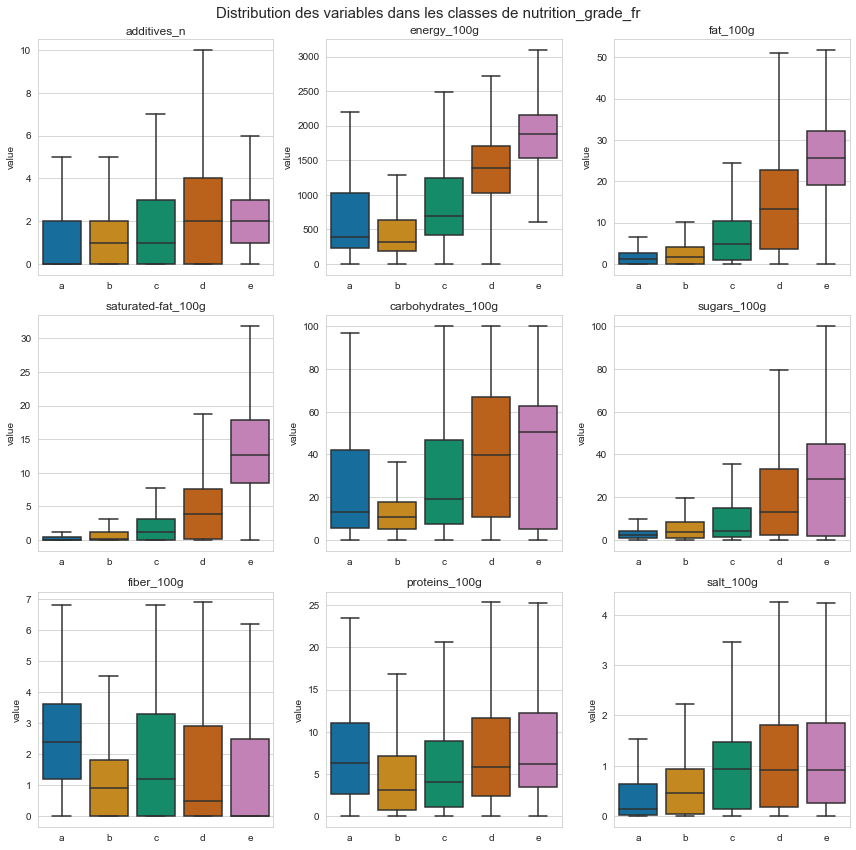

In [461]:
fig, axes = plt.subplots(3,3)
fig.set_size_inches(12, 12)
i=0
for col in df_test.describe().columns[:9]:
    ax=axes[i//3][i%3]
    sns.boxplot(x='nutrition_grade_fr',
               y=col,
               data=df_test,
               palette='colorblind',
               order=['a','b','c','d','e'],
               showfliers=False,
               ax=ax
               )
    ax.set_title(f'{col}')
    ax.set_xlabel('')
    ax.set_ylabel('value')
    i+=1
fig.suptitle('Distribution des variables dans les classes de nutrition_grade_fr',fontsize=15)
plt.tight_layout()
plt.show()

In [463]:

def anova_multiple_p(data,cols):
    R=[]
    for col in cols:
        df_test=data.dropna(subset=cols)
        p=f_oneway(df_test[df_test.nutrition_grade_fr=='a'][col],
                   df_test[df_test.nutrition_grade_fr=='b'][col],
                   df_test[df_test.nutrition_grade_fr=='c'][col],
                   df_test[df_test.nutrition_grade_fr=='d'][col],
                   df_test[df_test.nutrition_grade_fr=='e'][col]
        )[1]
        R.append(p)
    return R

In [ ]:
anova_multiple_p(df_test,['saturated-fat_100g',
                          'proteins_100g',
                          'carbohydrates_100g',
                          'fiber_100g',
                          'energy_100g'
                         ]
                )

In [ ]:
anova=[]
for a in np.arange(50,600,25):
    for i in range(20):
        df=df_test.sample(a)
        anova.append([a]+anova_multiple_p(df,['saturated-fat_100g',
                                          'proteins_100g',
                                          'carbohydrates_100g',
                                          'fiber_100g',
                                          'energy_100g'
                                         ]
                                     )
                )



In [ ]:
anova=pd.DataFrame(anova,columns=['samples','saturated-fat_100g',
                              'proteins_100g',
                              'carbohydrates_100g',
                              'fiber_100g',
                              'energy_100g'
                             ]
                  )

In [ ]:
anova_mean=anova.pivot_table(index=['samples'])

In [ ]:

fig, ax = plt.subplots(figsize=(8,8))
for i in range(anova_mean.shape[1]):
   plt.plot(anova_mean.iloc[:,i],label=anova_mean.columns[i])

handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc=5)
plt.xlabel('taille de l\'échantillon')
plt.ylabel('moyenne des p-value')
plt.title('Moyenne des p-value du test oneway Anova sur 20 échantillonnages')
plt.show()

##### Avec les variables in_US et in_EU

In [ ]:
from scipy.stats import chi2_contingency

In [ ]:
df_test = df_test.dropna(subset=['in_US','nutrition_grade_fr'])

In [ ]:
df_cross_us = pd.crosstab(index=df_test['in_US'],columns=df_test['nutrition_grade_fr'])

In [ ]:
df_cross_us.loc[0]=df_cross_us.loc[0]/df_cross_us.loc[0].sum()
df_cross_us.loc[1]=df_cross_us.loc[1]/df_cross_us.loc[1].sum()

In [ ]:
df_cross_eu = pd.crosstab(index=df_test['in_EU'],columns=df_test['nutrition_grade_fr'])

In [ ]:
df_cross_eu=df_cross_eu/df_cross_eu.sum(axis=0)

In [ ]:
df_cross_eu.loc[0]=df_cross_eu.loc[0]/df_cross_eu.loc[0].sum()
df_cross_eu.loc[1]=df_cross_eu.loc[1]/df_cross_eu.loc[1].sum()

In [ ]:
chi2_contingency(df_cross_us)

In [ ]:
chi2_contingency(df_cross_eu)